<a href="https://colab.research.google.com/github/bharathraj-v/geoml-wd/blob/main/notebooks/unet_benchmark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Solar Panel Segmentation using U-Net

####Importing libraries

In [1]:
import numpy as np 
import pandas as pd 
import tensorflow as tf
from zipfile import ZipFile 
import keras.backend as K
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import os

####Loading the Dataset

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!cp /content/drive/MyDrive/PV01.zip /content/

In [4]:
!unzip PV01.zip

Archive:  PV01.zip
   creating: PV01/
   creating: PV01/PV01_Rooftop_Brick/
  inflating: PV01/PV01_Rooftop_Brick/PV01_324942_1203839.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324942_1203839_label.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324942_1203842.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324942_1203842_label.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324951_1203793.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324951_1203793_label.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324951_1203795.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324951_1203795_label.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324956_1203801.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324956_1203801_label.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324956_1203803.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324956_1203803_label.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324958_1203801.bmp  
  inflating: PV01/PV01_Rooftop_Brick/PV01_324958_1203801_label.bmp  


In [5]:
brick = "PV01/PV01_Rooftop_Brick"
flatConcrete = "PV01/PV01_Rooftop_FlatConcrete"
steelTile = "PV01/PV01_Rooftop_SteelTile"

In [6]:
brick_paths = []
flatConcrete_paths = []
steelTile_paths = []

for root, dirs, files in os.walk(brick):
    for file in files:
        brick_paths.append(os.path.join(root, file))

for root, dirs, files in os.walk(flatConcrete):
    for file in files:
        flatConcrete_paths.append(os.path.join(root, file))

for root, dirs, files in os.walk(steelTile):
    for file in files:
        steelTile_paths.append(os.path.join(root, file))

In [7]:
brick_paths[:10]

['PV01/PV01_Rooftop_Brick/PV01_324972_1203798.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325237_1203816.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325364_1203805.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325496_1203757.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325122_1203837_label.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325120_1203763_label.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325500_1203825.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325500_1203825_label.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325120_1203763.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325565_1204537_label.bmp']

In [8]:
brick_paths.sort()
flatConcrete_paths.sort()
steelTile_paths.sort()

In [9]:
brick_img, brick_label = [brick_paths[i] for i in range(0,len(brick_paths),2)], [brick_paths[i] for i in range(1,len(brick_paths),2)]
flatConcrete_img, flatConcrete_label = [flatConcrete_paths[i] for i in range(0,len(flatConcrete_paths),2)], [flatConcrete_paths[i] for i in range(1,len(flatConcrete_paths),2)]
steelTile_img, steelTile_label = [steelTile_paths[i] for i in range(0,len(steelTile_paths),2)], [steelTile_paths[i] for i in range(1,len(steelTile_paths),2)]


In [10]:
images = np.concatenate((brick_img, flatConcrete_img, steelTile_img))

In [11]:
len(images) == len(brick_img)+ len(flatConcrete_img) + len(steelTile_img)

True

In [12]:
masks = np.concatenate((brick_label,flatConcrete_label,steelTile_label  ))

In [13]:
np.shape(images), np.shape(masks)

((645,), (645,))

In [14]:
images[50], masks[50]

('PV01/PV01_Rooftop_Brick/PV01_325337_1203789.bmp',
 'PV01/PV01_Rooftop_Brick/PV01_325337_1203789_label.bmp')

#### Visualizing the data

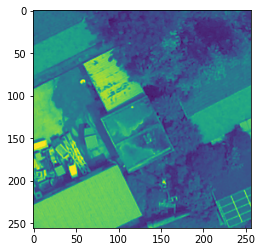

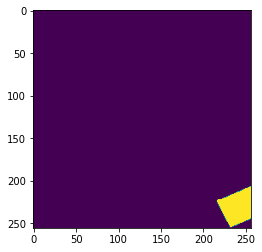

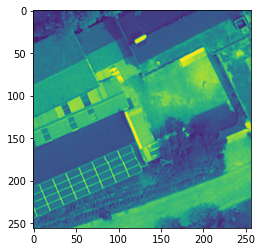

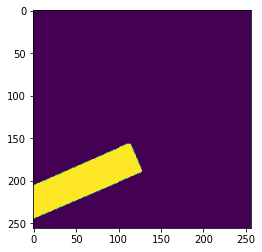

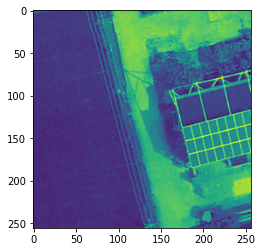

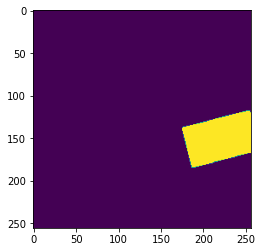

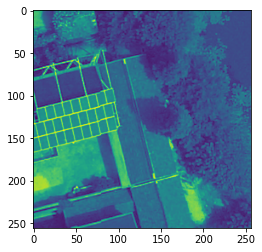

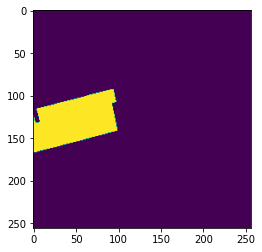

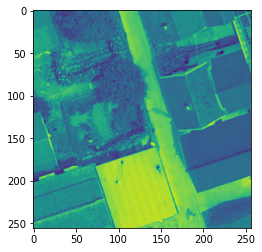

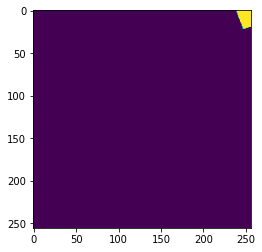

In [15]:
import cv2
for i in range(5):
  image = cv2.imread(images[i], cv2.IMREAD_GRAYSCALE)
  plt.imshow(image)
  plt.show()
  mask = cv2.imread(masks[i], cv2.IMREAD_GRAYSCALE)
  plt.imshow(mask)
  plt.show()


In [16]:
df = pd.DataFrame(columns = ['path', 'mask_path', 'class'])
df['path'] = images
df['mask_path'] = masks
df['class'] = 1

df.head(10)

,path,mask_path,class
0,PV01/PV01_Rooftop_Brick/PV01_324942_1203839.bmp,PV01/PV01_Rooftop_Brick/PV01_324942_1203839_la...,1
1,PV01/PV01_Rooftop_Brick/PV01_324942_1203842.bmp,PV01/PV01_Rooftop_Brick/PV01_324942_1203842_la...,1
2,PV01/PV01_Rooftop_Brick/PV01_324951_1203793.bmp,PV01/PV01_Rooftop_Brick/PV01_324951_1203793_la...,1
3,PV01/PV01_Rooftop_Brick/PV01_324951_1203795.bmp,PV01/PV01_Rooftop_Brick/PV01_324951_1203795_la...,1
4,PV01/PV01_Rooftop_Brick/PV01_324956_1203801.bmp,PV01/PV01_Rooftop_Brick/PV01_324956_1203801_la...,1
5,PV01/PV01_Rooftop_Brick/PV01_324956_1203803.bmp,PV01/PV01_Rooftop_Brick/PV01_324956_1203803_la...,1
6,PV01/PV01_Rooftop_Brick/PV01_324958_1203801.bmp,PV01/PV01_Rooftop_Brick/PV01_324958_1203801_la...,1
7,PV01/PV01_Rooftop_Brick/PV01_324958_1203803.bmp,PV01/PV01_Rooftop_Brick/PV01_324958_1203803_la...,1
8,PV01/PV01_Rooftop_Brick/PV01_324972_1203798.bmp,PV01/PV01_Rooftop_Brick/PV01_324972_1203798_la...,1
9,PV01/PV01_Rooftop_Brick/PV01_324972_1203801.bmp,PV01/PV01_Rooftop_Brick/PV01_324972_1203801_la...,1


### Setting up the Train & Test Data

In [17]:
df0 = df
n=len(df)
df=df0.iloc[0:(n//10)*3]
test_df=df0.iloc[(n//10)*3:(n//10)*4]

In [18]:
img_size = [256,256]

def data_augmentation(car_img, mask_img):
    if tf.random.uniform(()) > 0.5:
        car_img = tf.image.flip_left_right(car_img)
        mask_img = tf.image.flip_left_right(mask_img)

    return car_img, mask_img


def preprocessing(car_path, mask_path):
    car_img = tf.io.read_file(car_path) 
    car_img = tf.image.decode_bmp(car_img, channels=3)
    car_img = tf.image.resize(car_img, img_size)
    car_img = tf.cast(car_img, tf.float32) / 255.0
    
    mask_img = tf.io.read_file(mask_path)
    mask_img = tf.image.decode_bmp(mask_img, channels=3)
    mask_img = tf.image.resize(mask_img, img_size)
    mask_img = mask_img[:,:,:1]    
    mask_img = tf.math.sign(mask_img)
    
    return car_img, mask_img

def create_dataset(df, train = False):
    if not train:
        ds = tf.data.Dataset.from_tensor_slices((df["path"].values, df["mask_path"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
    else:
        ds = tf.data.Dataset.from_tensor_slices((df["path"].values, df["mask_path"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
        ds = ds.map(data_augmentation, tf.data.AUTOTUNE)

    return ds

In [19]:
train_df, valid_df = train_test_split(df, random_state=42, test_size=.25)
train = create_dataset(train_df, train = True)
valid = create_dataset(valid_df)
test = create_dataset(test_df)

In [20]:
TRAIN_LENGTH = len(train_df)
BATCH_SIZE = 16
BUFFER_SIZE = 1000

In [21]:
train_dataset = train.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset = train_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
valid_dataset = valid.batch(BATCH_SIZE)
test_dataset = test.batch(BATCH_SIZE)

In [22]:
def display(display_list):
    plt.figure(figsize=(12,12))
    title = ['Input Image','True Mask','Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

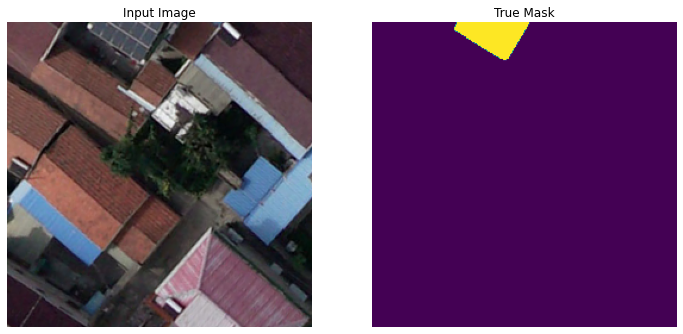

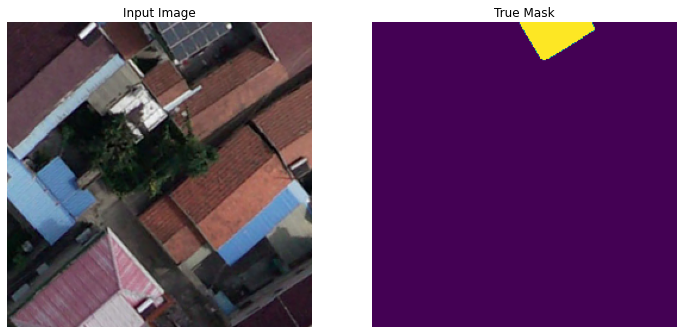

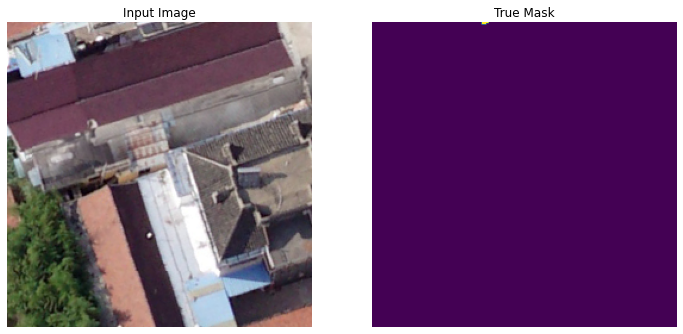

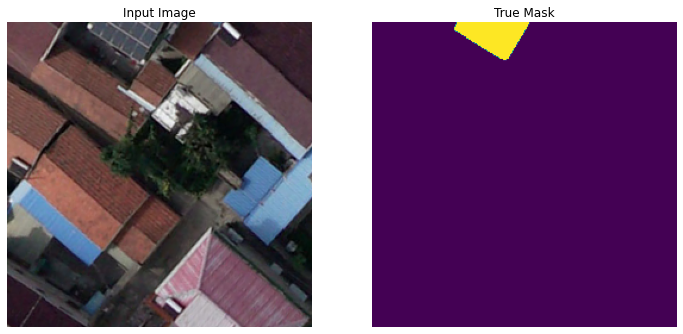

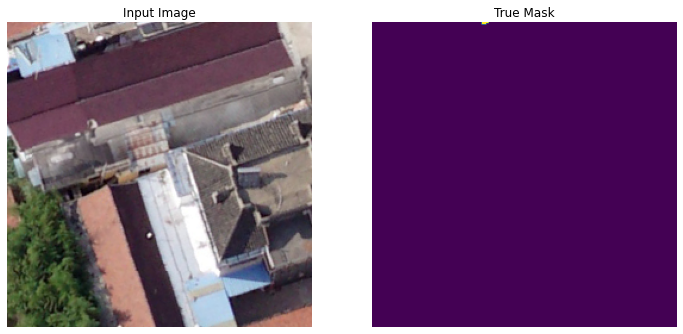

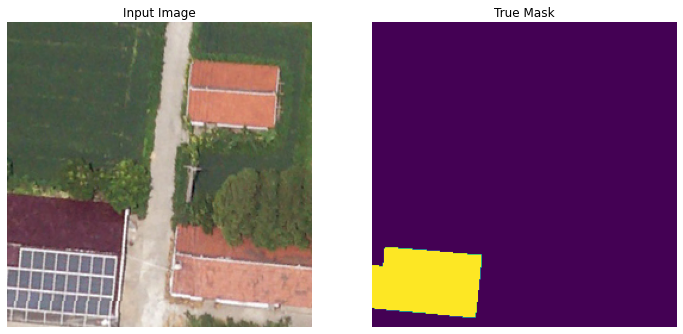

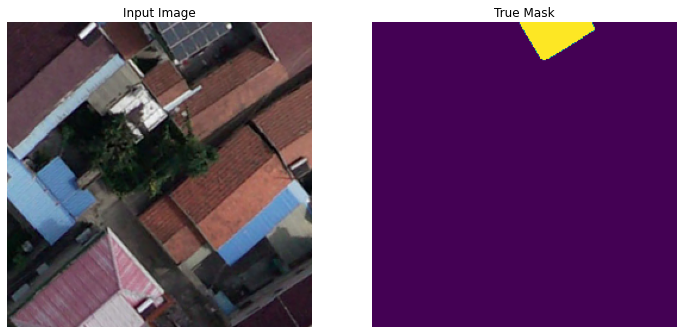

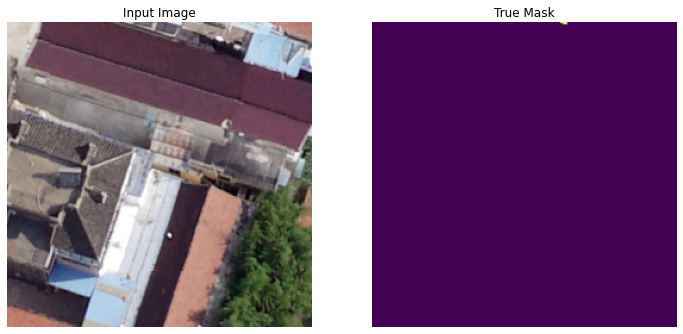

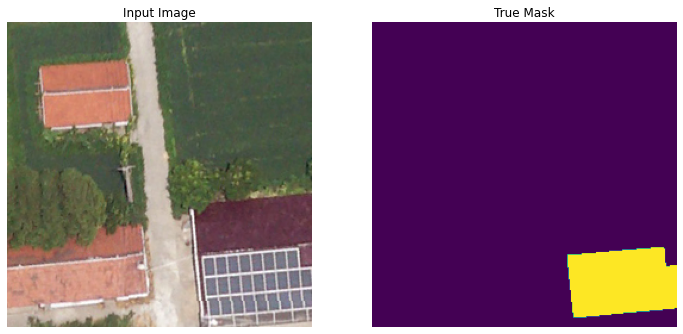

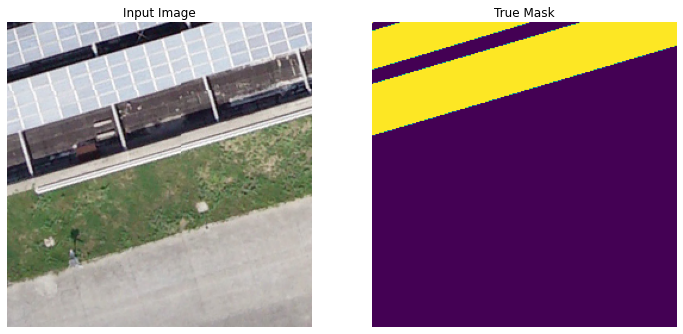

In [23]:
for i in range(5):
    for image, mask in train.take(i):
        sample_image, sample_mask = image, mask
        display([sample_image, sample_mask])

### U-Net Model with Pretrained MobileNetV2 as Encoder

In [24]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[256,256,3], include_top=False)

layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)
down_stack.trainable = False

9406464/9406464 [==============================] - 0s 0us/step


In [25]:
def upsample(filters, size, norm_type='batchnorm', apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    
    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    if norm_type.lower() == 'batchnorm':
        result.add(tf.keras.layers.BatchNormalization())
    elif norm_type.lower() == 'instancenorm':
        result.add(InstanceNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
        result.add(tf.keras.layers.ReLU())

    return result

up_stack = [
    upsample(512, 3),  # 4x4 -> 8x8
    upsample(256, 3),  # 8x8 -> 16x16
    upsample(128, 3),  # 16x16 -> 32x32
    upsample(64, 3),   # 32x32 -> 64x64
]

In [26]:
def unet_model(output_channels):
    inputs = tf.keras.layers.Input(shape=[256,256,3])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

  # This is the last layer of the model
    last = tf.keras.layers.Conv2DTranspose(
      output_channels, 3, strides=2, activation='sigmoid',
      padding='same')  #64x64 -> 128x128

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)
     


### Training the Model

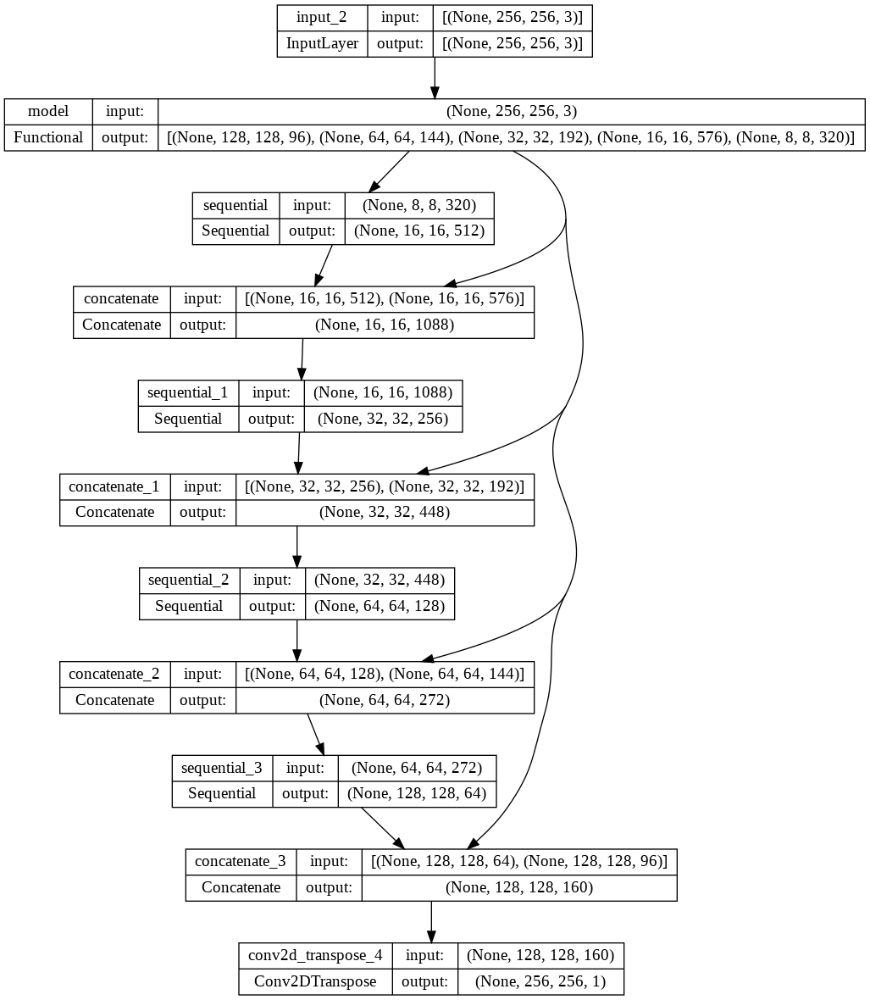

In [27]:
def dice_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(y_true * y_pred, axis=[1,2,3])
    union = K.sum(y_true, axis=[1,2,3]) + K.sum(y_pred, axis=[1,2,3])
    return K.mean( (2. * intersection + smooth) / (union + smooth), axis=0)

def dice_loss(in_gt, in_pred):
    return 1-dice_coef(in_gt, in_pred)

model = unet_model(1)

model.compile(optimizer='adam',
              loss = dice_loss,
              metrics=[dice_coef,'binary_accuracy'])

tf.keras.utils.plot_model(model, show_shapes=True)

In [28]:
def visualize(display_list):
    plt.figure(figsize=(12,12))
    title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

def show_predictions(sample_image, sample_mask):
    pred_mask = model.predict(sample_image[tf.newaxis, ...])
    pred_mask = pred_mask.reshape(img_size[0],img_size[1],1)
    visualize([sample_image, sample_mask, pred_mask])

1/1 [==============================] - 9s 9s/step


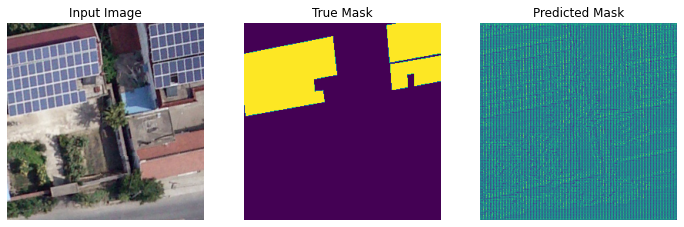

1/1 [==============================] - 0s 20ms/step


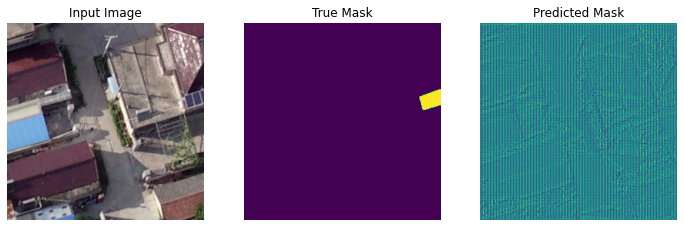

1/1 [==============================] - 0s 39ms/step


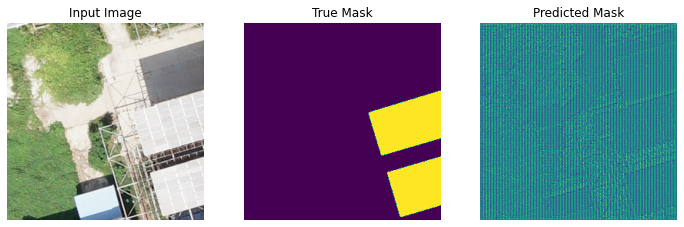

1/1 [==============================] - 0s 20ms/step


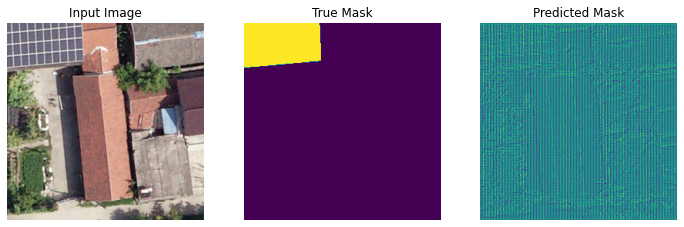

1/1 [==============================] - 0s 21ms/step


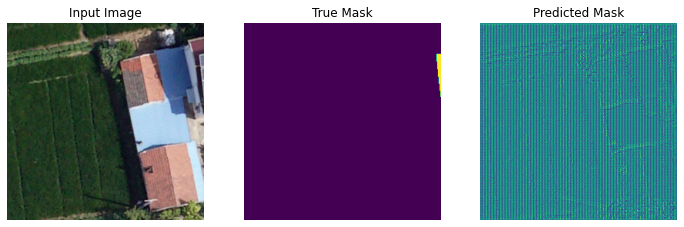

1/1 [==============================] - 0s 23ms/step


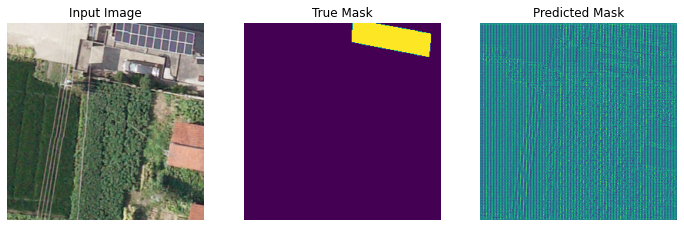

1/1 [==============================] - 0s 24ms/step


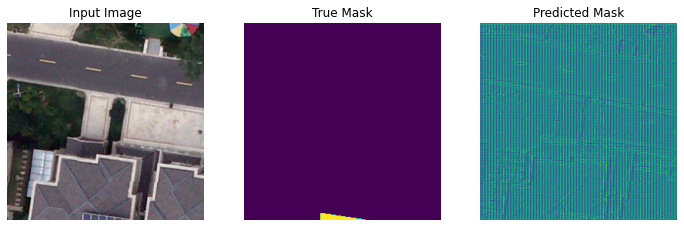

1/1 [==============================] - 0s 22ms/step


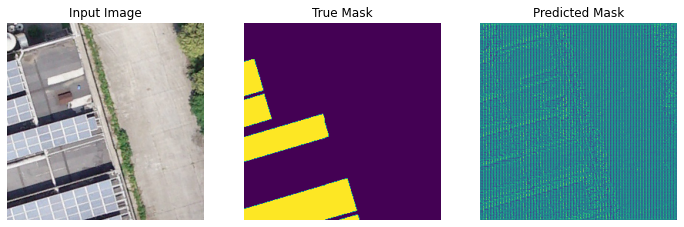

1/1 [==============================] - 0s 21ms/step


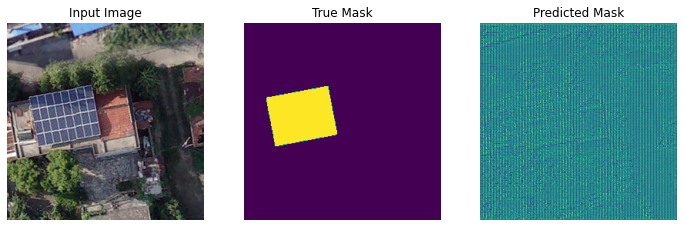

1/1 [==============================] - 0s 25ms/step


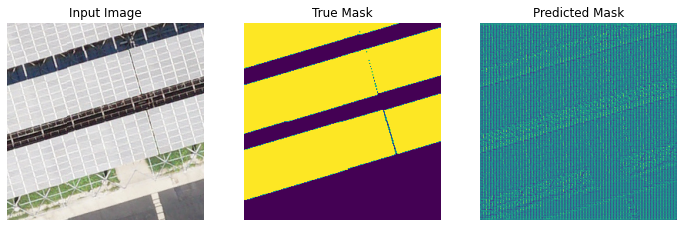

In [29]:
for i in range(5):
    for images, masks in train_dataset.take(i):
        for img, mask in zip(images, masks):
            sample_image = img
            sample_mask = mask
            show_predictions(sample_image, sample_mask)
            break

In [30]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 model (Functional)             [(None, 128, 128, 9  1841984     ['input_2[0][0]']                
                                6),                                                               
                                 (None, 64, 64, 144                                               
                                ),                                                                
                                 (None, 32, 32, 192                                         

Epoch 1/150
9/9 [==============================] - 1s 158ms/step - loss: 0.0566 - dice_coef: 0.9434 - binary_accuracy: 0.9857 - val_loss: 0.2240 - val_dice_coef: 0.7760 - val_binary_accuracy: 0.9758
Epoch 2/150
1/1 [==============================] - 0s 21ms/step


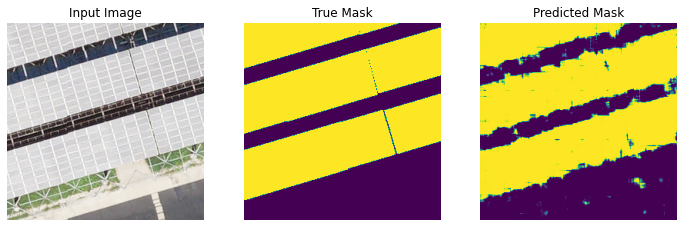

Epoch 3/150
9/9 [==============================] - 1s 148ms/step - loss: 0.0844 - dice_coef: 0.9156 - binary_accuracy: 0.9799 - val_loss: 0.2344 - val_dice_coef: 0.7656 - val_binary_accuracy: 0.9705
Epoch 4/150
9/9 [==============================] - 1s 132ms/step - loss: 0.1016 - dice_coef: 0.8984 - binary_accuracy: 0.9748 - val_loss: 0.2571 - val_dice_coef: 0.7429 - val_binary_accuracy: 0.9704
Epoch 5/150
1/1 [==============================] - 0s 29ms/step


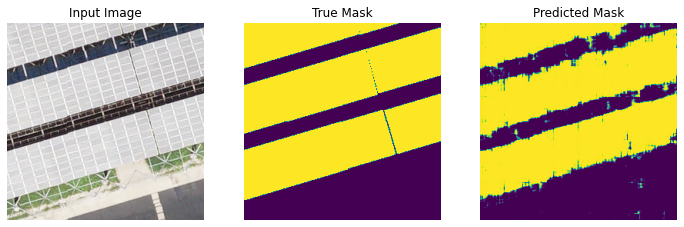

Epoch 6/150
9/9 [==============================] - 1s 132ms/step - loss: 0.0644 - dice_coef: 0.9356 - binary_accuracy: 0.9839 - val_loss: 0.2282 - val_dice_coef: 0.7718 - val_binary_accuracy: 0.9732
Epoch 7/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0676 - dice_coef: 0.9324 - binary_accuracy: 0.9826 - val_loss: 0.2242 - val_dice_coef: 0.7758 - val_binary_accuracy: 0.9761
Epoch 8/150
1/1 [==============================] - 0s 23ms/step


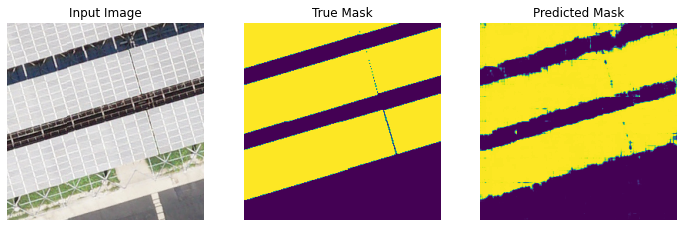

Epoch 9/150
9/9 [==============================] - 1s 133ms/step - loss: 0.0587 - dice_coef: 0.9413 - binary_accuracy: 0.9838 - val_loss: 0.2348 - val_dice_coef: 0.7652 - val_binary_accuracy: 0.9673
Epoch 10/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0509 - dice_coef: 0.9491 - binary_accuracy: 0.9871 - val_loss: 0.2235 - val_dice_coef: 0.7765 - val_binary_accuracy: 0.9767
Epoch 11/150
1/1 [==============================] - 0s 21ms/step


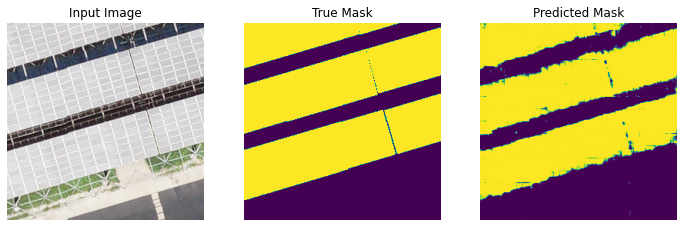

Epoch 12/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0524 - dice_coef: 0.9476 - binary_accuracy: 0.9867 - val_loss: 0.2266 - val_dice_coef: 0.7734 - val_binary_accuracy: 0.9746
Epoch 13/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0739 - dice_coef: 0.9261 - binary_accuracy: 0.9820 - val_loss: 0.2595 - val_dice_coef: 0.7405 - val_binary_accuracy: 0.9649
Epoch 14/150
1/1 [==============================] - 0s 23ms/step


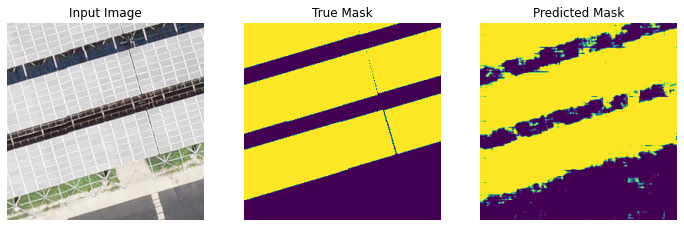

Epoch 15/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0731 - dice_coef: 0.9269 - binary_accuracy: 0.9818 - val_loss: 0.2385 - val_dice_coef: 0.7615 - val_binary_accuracy: 0.9737
Epoch 16/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0774 - dice_coef: 0.9226 - binary_accuracy: 0.9806 - val_loss: 0.2413 - val_dice_coef: 0.7587 - val_binary_accuracy: 0.9733
Epoch 17/150
1/1 [==============================] - 0s 20ms/step


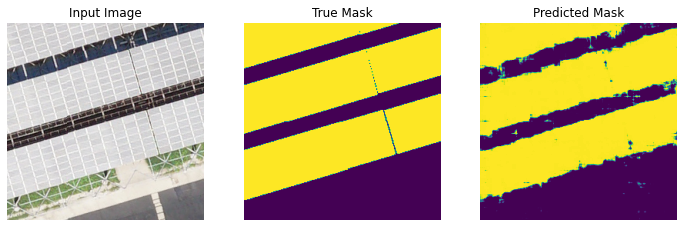

Epoch 18/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0665 - dice_coef: 0.9335 - binary_accuracy: 0.9818 - val_loss: 0.2216 - val_dice_coef: 0.7784 - val_binary_accuracy: 0.9777
Epoch 19/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0580 - dice_coef: 0.9420 - binary_accuracy: 0.9860 - val_loss: 0.2360 - val_dice_coef: 0.7640 - val_binary_accuracy: 0.9699
Epoch 20/150
1/1 [==============================] - 0s 21ms/step


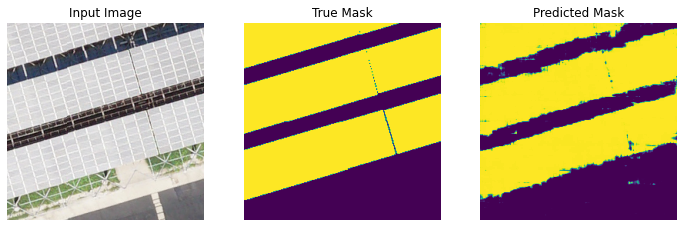

Epoch 21/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0559 - dice_coef: 0.9441 - binary_accuracy: 0.9856 - val_loss: 0.2305 - val_dice_coef: 0.7695 - val_binary_accuracy: 0.9744
Epoch 22/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0733 - dice_coef: 0.9267 - binary_accuracy: 0.9822 - val_loss: 0.2410 - val_dice_coef: 0.7590 - val_binary_accuracy: 0.9704
Epoch 23/150
1/1 [==============================] - 0s 20ms/step


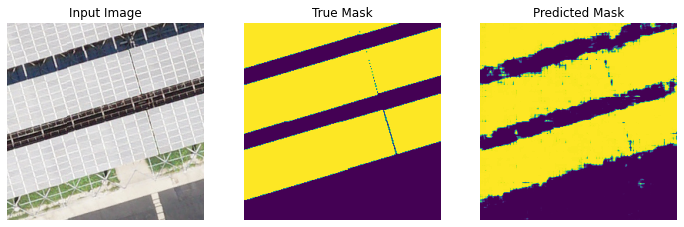

Epoch 24/150
9/9 [==============================] - 1s 151ms/step - loss: 0.0693 - dice_coef: 0.9307 - binary_accuracy: 0.9821 - val_loss: 0.2451 - val_dice_coef: 0.7549 - val_binary_accuracy: 0.9738
Epoch 25/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0543 - dice_coef: 0.9457 - binary_accuracy: 0.9863 - val_loss: 0.2353 - val_dice_coef: 0.7647 - val_binary_accuracy: 0.9710
Epoch 26/150
1/1 [==============================] - 0s 22ms/step


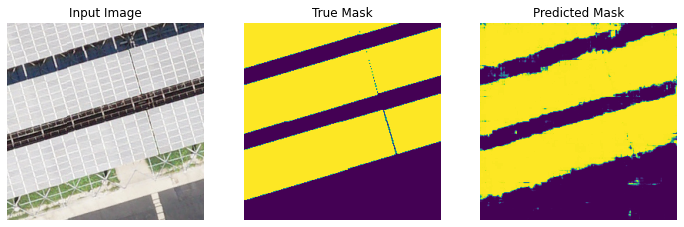

Epoch 27/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0609 - dice_coef: 0.9391 - binary_accuracy: 0.9836 - val_loss: 0.2343 - val_dice_coef: 0.7657 - val_binary_accuracy: 0.9729
Epoch 28/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0523 - dice_coef: 0.9477 - binary_accuracy: 0.9866 - val_loss: 0.2322 - val_dice_coef: 0.7678 - val_binary_accuracy: 0.9768
Epoch 29/150
1/1 [==============================] - 0s 23ms/step


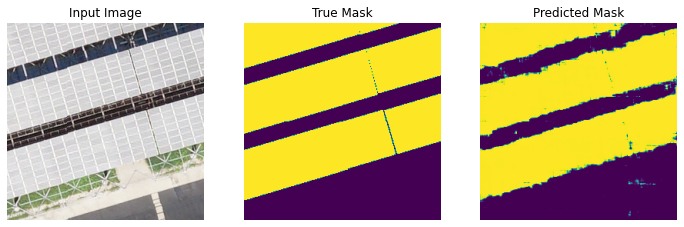

Epoch 30/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0551 - dice_coef: 0.9449 - binary_accuracy: 0.9852 - val_loss: 0.2351 - val_dice_coef: 0.7649 - val_binary_accuracy: 0.9733
Epoch 31/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0467 - dice_coef: 0.9533 - binary_accuracy: 0.9872 - val_loss: 0.2300 - val_dice_coef: 0.7700 - val_binary_accuracy: 0.9770
Epoch 32/150
1/1 [==============================] - 0s 20ms/step


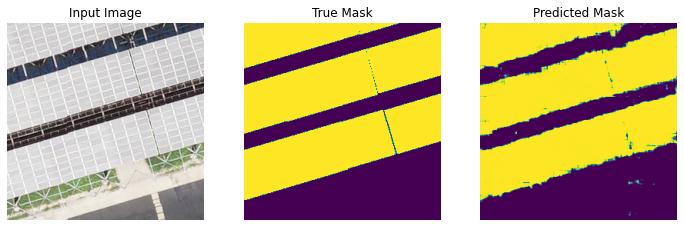

Epoch 33/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0493 - dice_coef: 0.9507 - binary_accuracy: 0.9867 - val_loss: 0.2306 - val_dice_coef: 0.7694 - val_binary_accuracy: 0.9733
Epoch 34/150
9/9 [==============================] - 1s 151ms/step - loss: 0.0527 - dice_coef: 0.9473 - binary_accuracy: 0.9866 - val_loss: 0.2289 - val_dice_coef: 0.7711 - val_binary_accuracy: 0.9774
Epoch 35/150
1/1 [==============================] - 0s 20ms/step


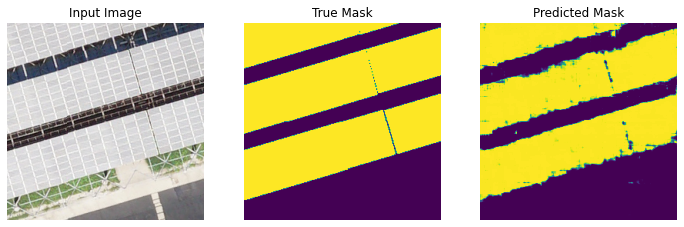

Epoch 36/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0448 - dice_coef: 0.9552 - binary_accuracy: 0.9869 - val_loss: 0.2284 - val_dice_coef: 0.7716 - val_binary_accuracy: 0.9769
Epoch 37/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0503 - dice_coef: 0.9497 - binary_accuracy: 0.9861 - val_loss: 0.2327 - val_dice_coef: 0.7673 - val_binary_accuracy: 0.9744
Epoch 38/150
1/1 [==============================] - 0s 20ms/step


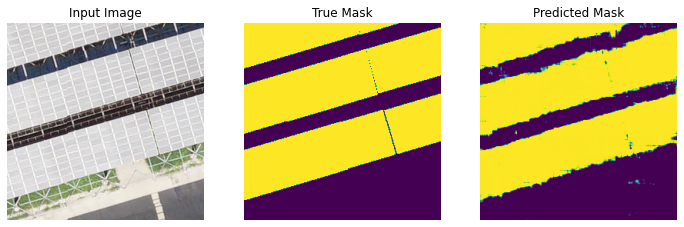

Epoch 39/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0450 - dice_coef: 0.9550 - binary_accuracy: 0.9873 - val_loss: 0.2259 - val_dice_coef: 0.7741 - val_binary_accuracy: 0.9784
Epoch 40/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0416 - dice_coef: 0.9584 - binary_accuracy: 0.9887 - val_loss: 0.2278 - val_dice_coef: 0.7722 - val_binary_accuracy: 0.9779
Epoch 41/150
1/1 [==============================] - 0s 21ms/step


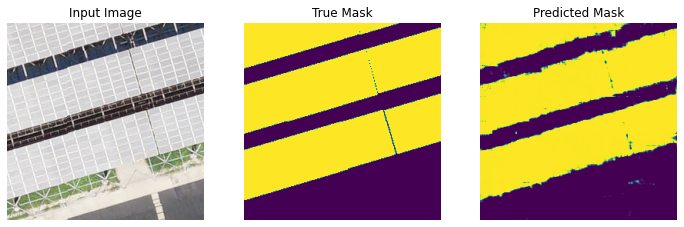

Epoch 42/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0462 - dice_coef: 0.9538 - binary_accuracy: 0.9846 - val_loss: 0.2261 - val_dice_coef: 0.7739 - val_binary_accuracy: 0.9782
Epoch 43/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0438 - dice_coef: 0.9562 - binary_accuracy: 0.9883 - val_loss: 0.2286 - val_dice_coef: 0.7714 - val_binary_accuracy: 0.9777
Epoch 44/150
1/1 [==============================] - 0s 20ms/step


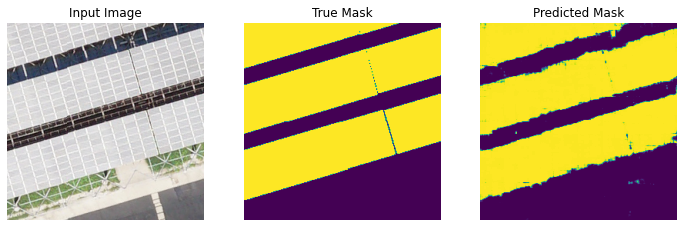

Epoch 45/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0436 - dice_coef: 0.9564 - binary_accuracy: 0.9877 - val_loss: 0.2284 - val_dice_coef: 0.7716 - val_binary_accuracy: 0.9782
Epoch 46/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0421 - dice_coef: 0.9579 - binary_accuracy: 0.9874 - val_loss: 0.2266 - val_dice_coef: 0.7734 - val_binary_accuracy: 0.9779
Epoch 47/150
1/1 [==============================] - 0s 21ms/step


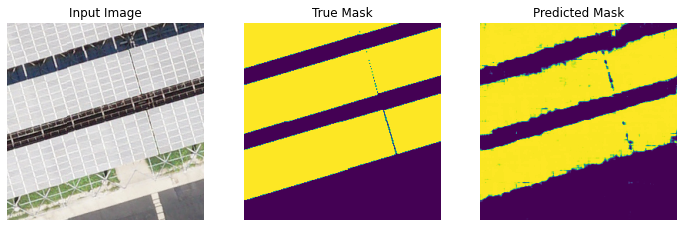

Epoch 48/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0497 - dice_coef: 0.9503 - binary_accuracy: 0.9864 - val_loss: 0.2373 - val_dice_coef: 0.7627 - val_binary_accuracy: 0.9783
Epoch 49/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0493 - dice_coef: 0.9507 - binary_accuracy: 0.9867 - val_loss: 0.2266 - val_dice_coef: 0.7734 - val_binary_accuracy: 0.9763
Epoch 50/150
1/1 [==============================] - 0s 27ms/step


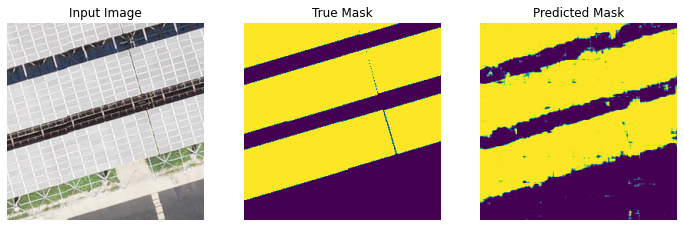

Epoch 51/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0679 - dice_coef: 0.9321 - binary_accuracy: 0.9771 - val_loss: 0.2308 - val_dice_coef: 0.7692 - val_binary_accuracy: 0.9769
Epoch 52/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0603 - dice_coef: 0.9397 - binary_accuracy: 0.9858 - val_loss: 0.2339 - val_dice_coef: 0.7661 - val_binary_accuracy: 0.9724
Epoch 53/150
1/1 [==============================] - 0s 27ms/step


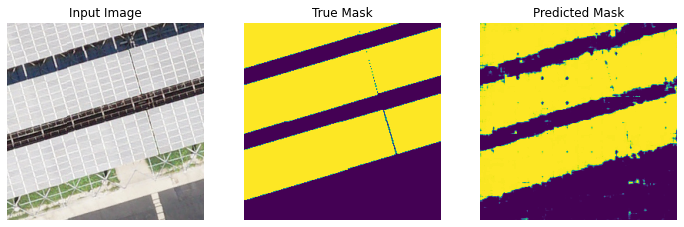

Epoch 54/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0449 - dice_coef: 0.9551 - binary_accuracy: 0.9874 - val_loss: 0.2276 - val_dice_coef: 0.7724 - val_binary_accuracy: 0.9754
Epoch 55/150
9/9 [==============================] - 1s 134ms/step - loss: 0.0477 - dice_coef: 0.9523 - binary_accuracy: 0.9849 - val_loss: 0.2268 - val_dice_coef: 0.7732 - val_binary_accuracy: 0.9777
Epoch 56/150
1/1 [==============================] - 0s 21ms/step


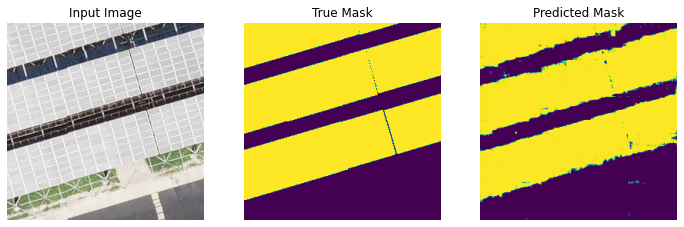

Epoch 57/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0403 - dice_coef: 0.9597 - binary_accuracy: 0.9886 - val_loss: 0.2279 - val_dice_coef: 0.7721 - val_binary_accuracy: 0.9772
Epoch 58/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0404 - dice_coef: 0.9596 - binary_accuracy: 0.9891 - val_loss: 0.2272 - val_dice_coef: 0.7728 - val_binary_accuracy: 0.9758
Epoch 59/150
1/1 [==============================] - 0s 23ms/step


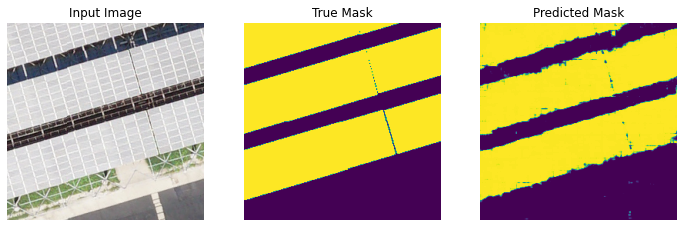

Epoch 60/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0406 - dice_coef: 0.9594 - binary_accuracy: 0.9887 - val_loss: 0.2289 - val_dice_coef: 0.7711 - val_binary_accuracy: 0.9779
Epoch 61/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0486 - dice_coef: 0.9514 - binary_accuracy: 0.9865 - val_loss: 0.2279 - val_dice_coef: 0.7721 - val_binary_accuracy: 0.9767
Epoch 62/150
1/1 [==============================] - 0s 19ms/step


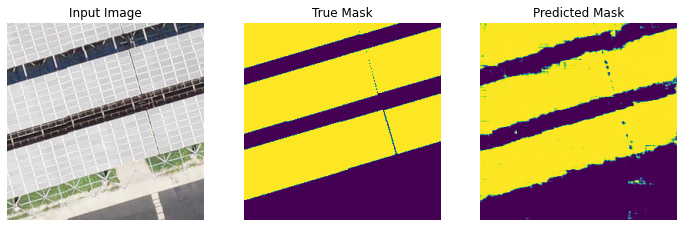

Epoch 63/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0443 - dice_coef: 0.9557 - binary_accuracy: 0.9869 - val_loss: 0.2245 - val_dice_coef: 0.7755 - val_binary_accuracy: 0.9775
Epoch 64/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0384 - dice_coef: 0.9616 - binary_accuracy: 0.9892 - val_loss: 0.2289 - val_dice_coef: 0.7711 - val_binary_accuracy: 0.9767
Epoch 65/150
1/1 [==============================] - 0s 19ms/step


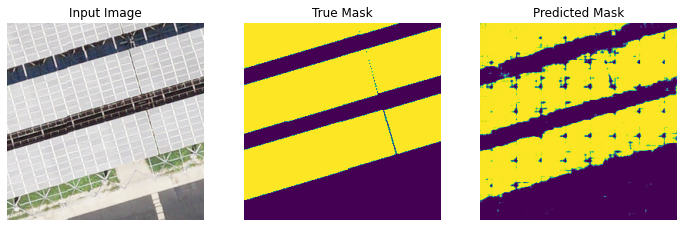

Epoch 66/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0540 - dice_coef: 0.9460 - binary_accuracy: 0.9854 - val_loss: 0.2589 - val_dice_coef: 0.7411 - val_binary_accuracy: 0.9726
Epoch 67/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0519 - dice_coef: 0.9481 - binary_accuracy: 0.9868 - val_loss: 0.2346 - val_dice_coef: 0.7654 - val_binary_accuracy: 0.9772
Epoch 68/150
1/1 [==============================] - 0s 24ms/step


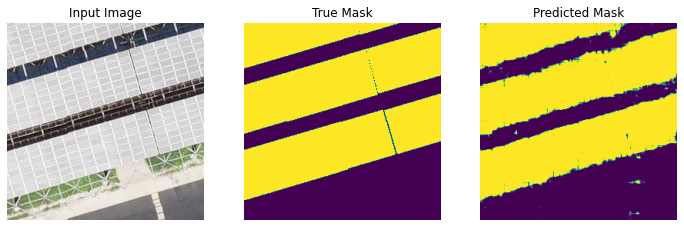

Epoch 69/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0481 - dice_coef: 0.9519 - binary_accuracy: 0.9865 - val_loss: 0.2322 - val_dice_coef: 0.7678 - val_binary_accuracy: 0.9771
Epoch 70/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0459 - dice_coef: 0.9541 - binary_accuracy: 0.9869 - val_loss: 0.2306 - val_dice_coef: 0.7694 - val_binary_accuracy: 0.9784
Epoch 71/150
1/1 [==============================] - 0s 20ms/step


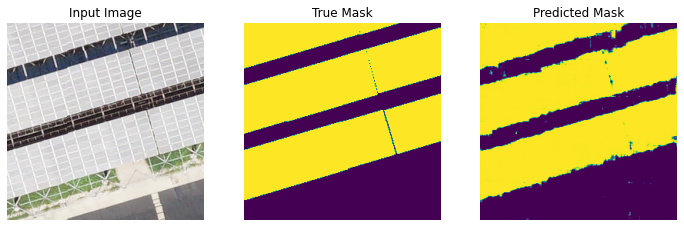

Epoch 72/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0414 - dice_coef: 0.9586 - binary_accuracy: 0.9875 - val_loss: 0.2268 - val_dice_coef: 0.7732 - val_binary_accuracy: 0.9770
Epoch 73/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0392 - dice_coef: 0.9608 - binary_accuracy: 0.9887 - val_loss: 0.2270 - val_dice_coef: 0.7730 - val_binary_accuracy: 0.9763
Epoch 74/150
1/1 [==============================] - 0s 21ms/step


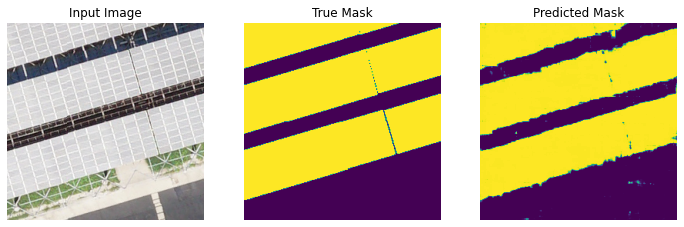

Epoch 75/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0492 - dice_coef: 0.9508 - binary_accuracy: 0.9873 - val_loss: 0.2425 - val_dice_coef: 0.7575 - val_binary_accuracy: 0.9741
Epoch 76/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0501 - dice_coef: 0.9499 - binary_accuracy: 0.9860 - val_loss: 0.2401 - val_dice_coef: 0.7599 - val_binary_accuracy: 0.9732
Epoch 77/150
1/1 [==============================] - 0s 20ms/step


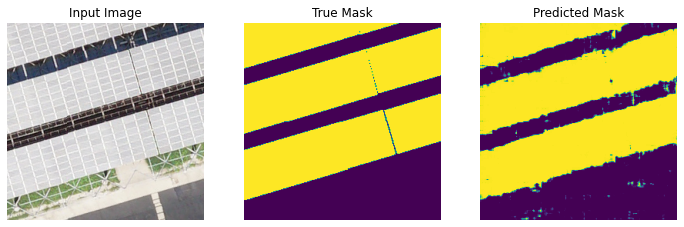

Epoch 78/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0543 - dice_coef: 0.9457 - binary_accuracy: 0.9844 - val_loss: 0.2322 - val_dice_coef: 0.7678 - val_binary_accuracy: 0.9759
Epoch 79/150
9/9 [==============================] - 1s 154ms/step - loss: 0.0482 - dice_coef: 0.9518 - binary_accuracy: 0.9873 - val_loss: 0.2318 - val_dice_coef: 0.7682 - val_binary_accuracy: 0.9772
Epoch 80/150
1/1 [==============================] - 0s 24ms/step


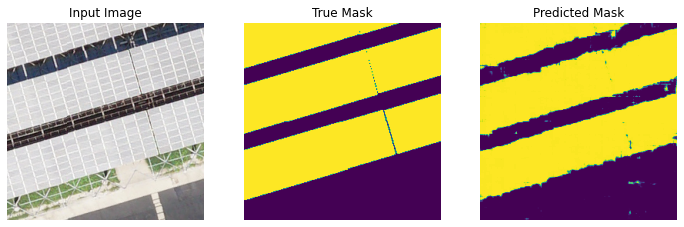

Epoch 81/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0406 - dice_coef: 0.9594 - binary_accuracy: 0.9883 - val_loss: 0.2293 - val_dice_coef: 0.7707 - val_binary_accuracy: 0.9791
Epoch 82/150
9/9 [==============================] - 1s 135ms/step - loss: 0.0405 - dice_coef: 0.9595 - binary_accuracy: 0.9887 - val_loss: 0.2342 - val_dice_coef: 0.7658 - val_binary_accuracy: 0.9732
Epoch 83/150
1/1 [==============================] - 0s 19ms/step


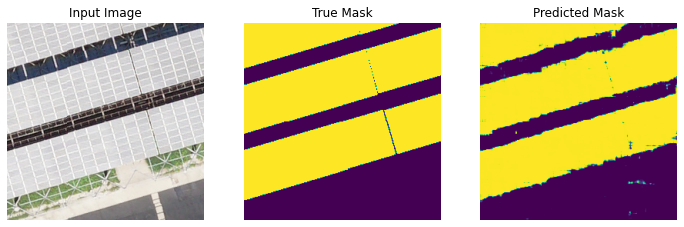

Epoch 84/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0355 - dice_coef: 0.9645 - binary_accuracy: 0.9896 - val_loss: 0.2290 - val_dice_coef: 0.7710 - val_binary_accuracy: 0.9774
Epoch 85/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0357 - dice_coef: 0.9643 - binary_accuracy: 0.9894 - val_loss: 0.2308 - val_dice_coef: 0.7692 - val_binary_accuracy: 0.9758
Epoch 86/150
1/1 [==============================] - 0s 23ms/step


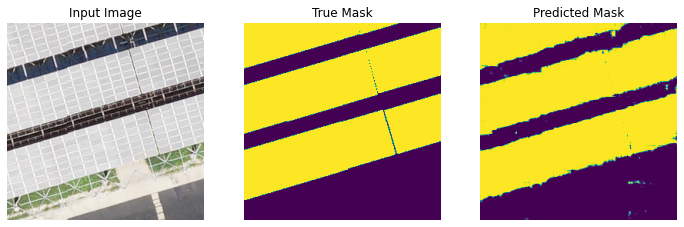

Epoch 87/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0347 - dice_coef: 0.9653 - binary_accuracy: 0.9900 - val_loss: 0.2327 - val_dice_coef: 0.7673 - val_binary_accuracy: 0.9755
Epoch 88/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0324 - dice_coef: 0.9676 - binary_accuracy: 0.9906 - val_loss: 0.2297 - val_dice_coef: 0.7703 - val_binary_accuracy: 0.9776
Epoch 89/150
1/1 [==============================] - 0s 20ms/step


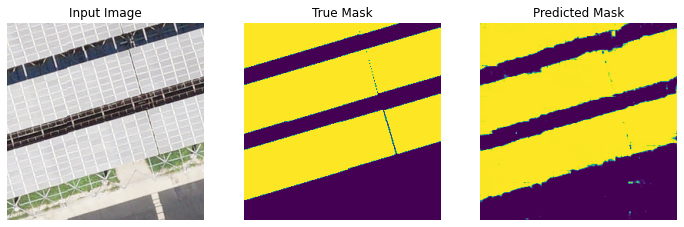

Epoch 90/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0319 - dice_coef: 0.9681 - binary_accuracy: 0.9908 - val_loss: 0.2306 - val_dice_coef: 0.7694 - val_binary_accuracy: 0.9764
Epoch 91/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0333 - dice_coef: 0.9667 - binary_accuracy: 0.9900 - val_loss: 0.2325 - val_dice_coef: 0.7675 - val_binary_accuracy: 0.9762
Epoch 92/150
1/1 [==============================] - 0s 33ms/step


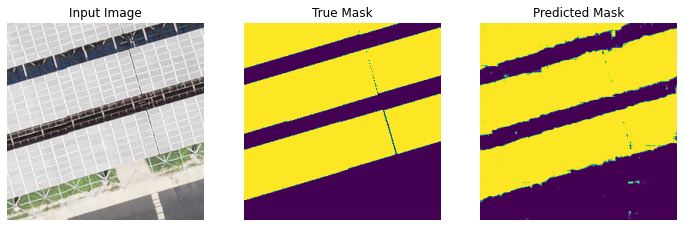

Epoch 93/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0328 - dice_coef: 0.9672 - binary_accuracy: 0.9902 - val_loss: 0.2321 - val_dice_coef: 0.7679 - val_binary_accuracy: 0.9764
Epoch 94/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0345 - dice_coef: 0.9655 - binary_accuracy: 0.9895 - val_loss: 0.2288 - val_dice_coef: 0.7712 - val_binary_accuracy: 0.9779
Epoch 95/150
1/1 [==============================] - 0s 26ms/step


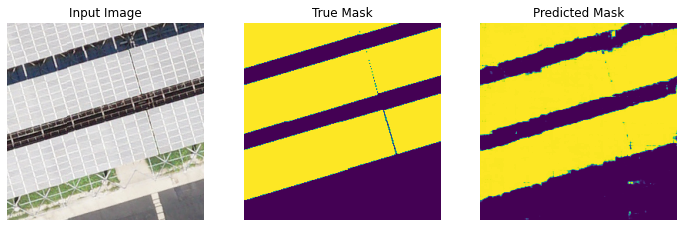

Epoch 96/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0315 - dice_coef: 0.9685 - binary_accuracy: 0.9906 - val_loss: 0.2330 - val_dice_coef: 0.7670 - val_binary_accuracy: 0.9768
Epoch 97/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0327 - dice_coef: 0.9673 - binary_accuracy: 0.9906 - val_loss: 0.2318 - val_dice_coef: 0.7682 - val_binary_accuracy: 0.9775
Epoch 98/150
1/1 [==============================] - 0s 30ms/step


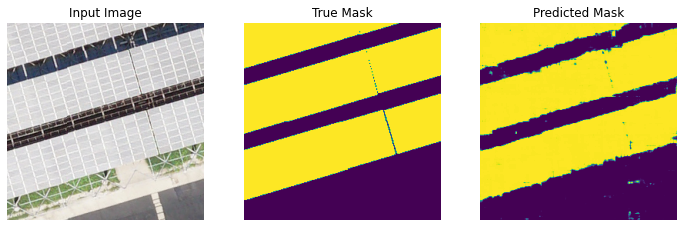

Epoch 99/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0343 - dice_coef: 0.9657 - binary_accuracy: 0.9899 - val_loss: 0.2288 - val_dice_coef: 0.7712 - val_binary_accuracy: 0.9780
Epoch 100/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0303 - dice_coef: 0.9697 - binary_accuracy: 0.9912 - val_loss: 0.2281 - val_dice_coef: 0.7719 - val_binary_accuracy: 0.9781
Epoch 101/150
1/1 [==============================] - 0s 27ms/step


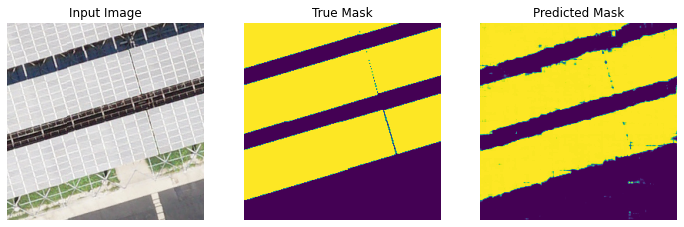

Epoch 102/150
9/9 [==============================] - 1s 140ms/step - loss: 0.0317 - dice_coef: 0.9683 - binary_accuracy: 0.9909 - val_loss: 0.2326 - val_dice_coef: 0.7674 - val_binary_accuracy: 0.9757
Epoch 103/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0342 - dice_coef: 0.9658 - binary_accuracy: 0.9910 - val_loss: 0.2306 - val_dice_coef: 0.7694 - val_binary_accuracy: 0.9770
Epoch 104/150
1/1 [==============================] - 0s 26ms/step


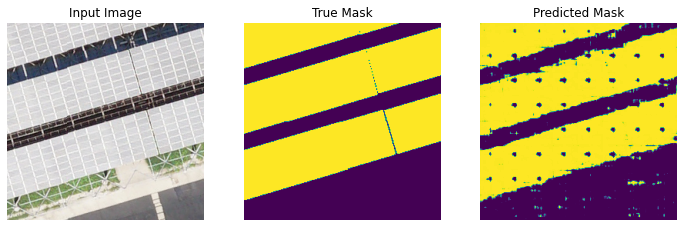

Epoch 105/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0615 - dice_coef: 0.9385 - binary_accuracy: 0.9838 - val_loss: 0.3368 - val_dice_coef: 0.6632 - val_binary_accuracy: 0.9550
Epoch 106/150
9/9 [==============================] - 1s 154ms/step - loss: 0.0701 - dice_coef: 0.9299 - binary_accuracy: 0.9834 - val_loss: 0.3369 - val_dice_coef: 0.6631 - val_binary_accuracy: 0.9517
Epoch 107/150
1/1 [==============================] - 0s 24ms/step


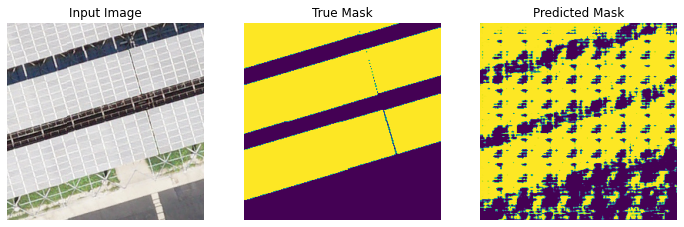

Epoch 108/150
9/9 [==============================] - 1s 137ms/step - loss: 0.1182 - dice_coef: 0.8818 - binary_accuracy: 0.9718 - val_loss: 0.4047 - val_dice_coef: 0.5953 - val_binary_accuracy: 0.9290
Epoch 109/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0946 - dice_coef: 0.9054 - binary_accuracy: 0.9759 - val_loss: 0.3427 - val_dice_coef: 0.6573 - val_binary_accuracy: 0.9507
Epoch 110/150
1/1 [==============================] - 0s 29ms/step


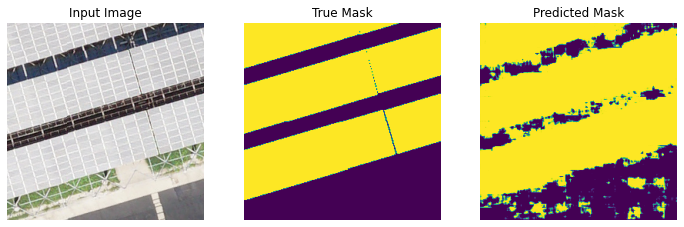

Epoch 111/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0666 - dice_coef: 0.9334 - binary_accuracy: 0.9826 - val_loss: 0.2493 - val_dice_coef: 0.7507 - val_binary_accuracy: 0.9685
Epoch 112/150
9/9 [==============================] - 1s 137ms/step - loss: 0.0565 - dice_coef: 0.9435 - binary_accuracy: 0.9850 - val_loss: 0.2531 - val_dice_coef: 0.7469 - val_binary_accuracy: 0.9737
Epoch 113/150
1/1 [==============================] - 0s 29ms/step


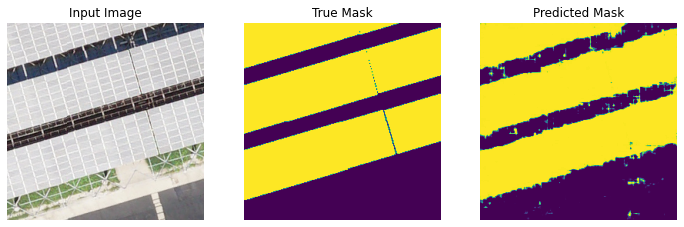

Epoch 114/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0459 - dice_coef: 0.9541 - binary_accuracy: 0.9886 - val_loss: 0.2390 - val_dice_coef: 0.7610 - val_binary_accuracy: 0.9768
Epoch 115/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0430 - dice_coef: 0.9570 - binary_accuracy: 0.9878 - val_loss: 0.2402 - val_dice_coef: 0.7598 - val_binary_accuracy: 0.9746
Epoch 116/150
1/1 [==============================] - 0s 28ms/step


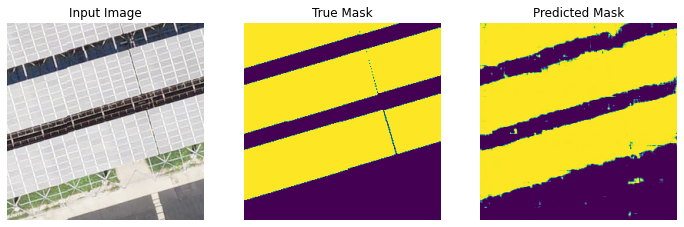

Epoch 117/150
9/9 [==============================] - 1s 154ms/step - loss: 0.0423 - dice_coef: 0.9577 - binary_accuracy: 0.9882 - val_loss: 0.2330 - val_dice_coef: 0.7670 - val_binary_accuracy: 0.9757
Epoch 118/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0437 - dice_coef: 0.9563 - binary_accuracy: 0.9866 - val_loss: 0.2330 - val_dice_coef: 0.7670 - val_binary_accuracy: 0.9771
Epoch 119/150
1/1 [==============================] - 0s 27ms/step


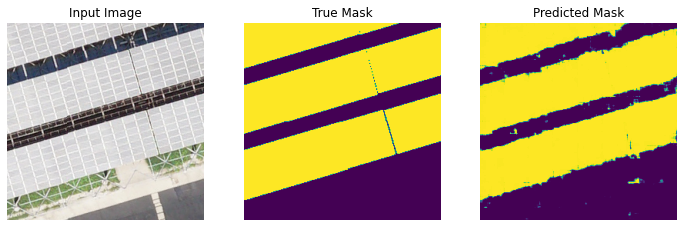

Epoch 120/150
9/9 [==============================] - 1s 154ms/step - loss: 0.0370 - dice_coef: 0.9630 - binary_accuracy: 0.9893 - val_loss: 0.2354 - val_dice_coef: 0.7646 - val_binary_accuracy: 0.9748
Epoch 121/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0404 - dice_coef: 0.9596 - binary_accuracy: 0.9864 - val_loss: 0.2344 - val_dice_coef: 0.7656 - val_binary_accuracy: 0.9774
Epoch 122/150
1/1 [==============================] - 0s 30ms/step


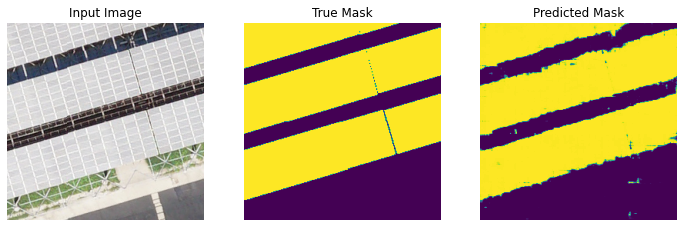

Epoch 123/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0359 - dice_coef: 0.9641 - binary_accuracy: 0.9894 - val_loss: 0.2381 - val_dice_coef: 0.7619 - val_binary_accuracy: 0.9747
Epoch 124/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0324 - dice_coef: 0.9676 - binary_accuracy: 0.9910 - val_loss: 0.2357 - val_dice_coef: 0.7643 - val_binary_accuracy: 0.9746
Epoch 125/150
1/1 [==============================] - 0s 29ms/step


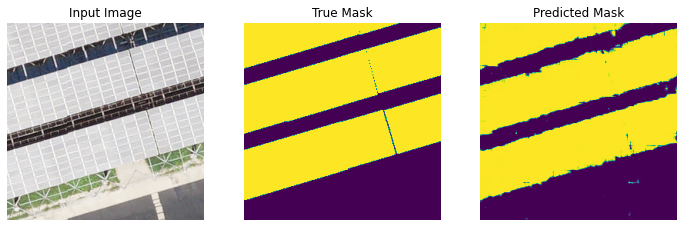

Epoch 126/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0337 - dice_coef: 0.9663 - binary_accuracy: 0.9907 - val_loss: 0.2325 - val_dice_coef: 0.7675 - val_binary_accuracy: 0.9757
Epoch 127/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0303 - dice_coef: 0.9697 - binary_accuracy: 0.9912 - val_loss: 0.2359 - val_dice_coef: 0.7641 - val_binary_accuracy: 0.9745
Epoch 128/150
1/1 [==============================] - 0s 29ms/step


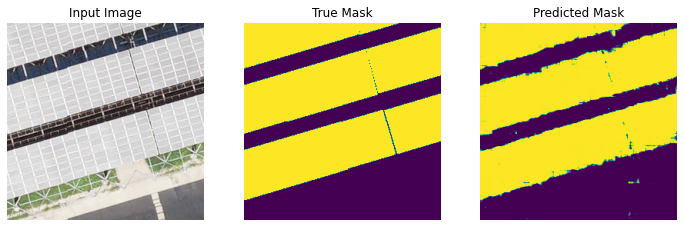

Epoch 129/150
9/9 [==============================] - 1s 136ms/step - loss: 0.0304 - dice_coef: 0.9696 - binary_accuracy: 0.9910 - val_loss: 0.2287 - val_dice_coef: 0.7713 - val_binary_accuracy: 0.9785
Epoch 130/150
9/9 [==============================] - 1s 154ms/step - loss: 0.0315 - dice_coef: 0.9685 - binary_accuracy: 0.9909 - val_loss: 0.2348 - val_dice_coef: 0.7652 - val_binary_accuracy: 0.9750
Epoch 131/150
1/1 [==============================] - 0s 35ms/step


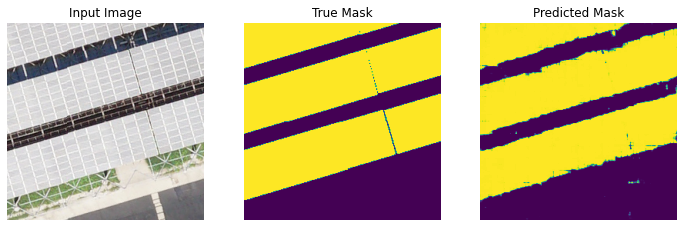

Epoch 132/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0300 - dice_coef: 0.9700 - binary_accuracy: 0.9914 - val_loss: 0.2354 - val_dice_coef: 0.7646 - val_binary_accuracy: 0.9753
Epoch 133/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0278 - dice_coef: 0.9722 - binary_accuracy: 0.9918 - val_loss: 0.2355 - val_dice_coef: 0.7645 - val_binary_accuracy: 0.9759
Epoch 134/150
1/1 [==============================] - 0s 30ms/step


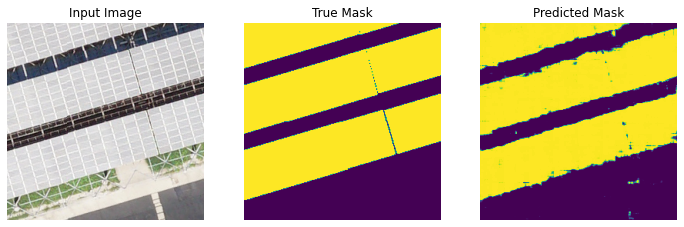

Epoch 135/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0300 - dice_coef: 0.9700 - binary_accuracy: 0.9912 - val_loss: 0.2321 - val_dice_coef: 0.7679 - val_binary_accuracy: 0.9771
Epoch 136/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0284 - dice_coef: 0.9716 - binary_accuracy: 0.9917 - val_loss: 0.2299 - val_dice_coef: 0.7701 - val_binary_accuracy: 0.9785
Epoch 137/150
1/1 [==============================] - 0s 20ms/step


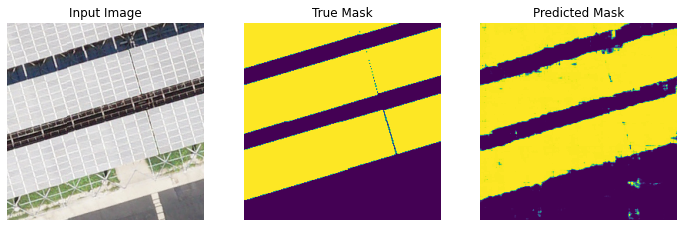

Epoch 138/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0344 - dice_coef: 0.9656 - binary_accuracy: 0.9904 - val_loss: 0.2329 - val_dice_coef: 0.7671 - val_binary_accuracy: 0.9768
Epoch 139/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0301 - dice_coef: 0.9699 - binary_accuracy: 0.9914 - val_loss: 0.2346 - val_dice_coef: 0.7654 - val_binary_accuracy: 0.9764
Epoch 140/150
1/1 [==============================] - 0s 35ms/step


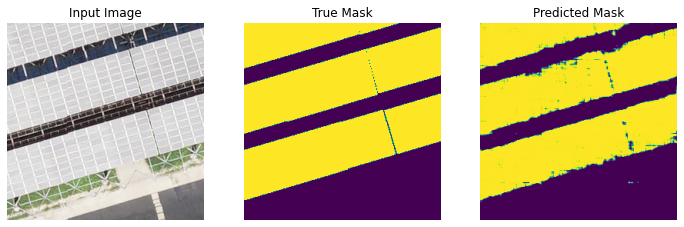

Epoch 141/150
9/9 [==============================] - 1s 139ms/step - loss: 0.0334 - dice_coef: 0.9666 - binary_accuracy: 0.9898 - val_loss: 0.2334 - val_dice_coef: 0.7666 - val_binary_accuracy: 0.9779
Epoch 142/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0300 - dice_coef: 0.9700 - binary_accuracy: 0.9911 - val_loss: 0.2366 - val_dice_coef: 0.7634 - val_binary_accuracy: 0.9744
Epoch 143/150
1/1 [==============================] - 0s 31ms/step


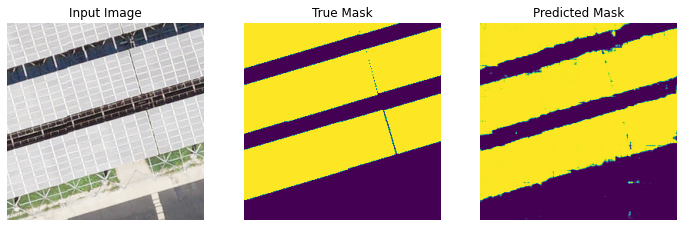

Epoch 144/150
9/9 [==============================] - 1s 152ms/step - loss: 0.0285 - dice_coef: 0.9715 - binary_accuracy: 0.9920 - val_loss: 0.2343 - val_dice_coef: 0.7657 - val_binary_accuracy: 0.9777
Epoch 145/150
9/9 [==============================] - 1s 138ms/step - loss: 0.0285 - dice_coef: 0.9715 - binary_accuracy: 0.9919 - val_loss: 0.2332 - val_dice_coef: 0.7668 - val_binary_accuracy: 0.9769
Epoch 146/150
1/1 [==============================] - 0s 33ms/step


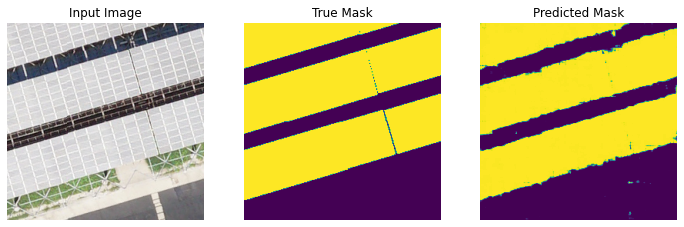

Epoch 147/150
9/9 [==============================] - 1s 140ms/step - loss: 0.0290 - dice_coef: 0.9710 - binary_accuracy: 0.9913 - val_loss: 0.2320 - val_dice_coef: 0.7680 - val_binary_accuracy: 0.9775
Epoch 148/150
9/9 [==============================] - 1s 153ms/step - loss: 0.0302 - dice_coef: 0.9698 - binary_accuracy: 0.9907 - val_loss: 0.2344 - val_dice_coef: 0.7656 - val_binary_accuracy: 0.9781
Epoch 149/150
1/1 [==============================] - 0s 30ms/step


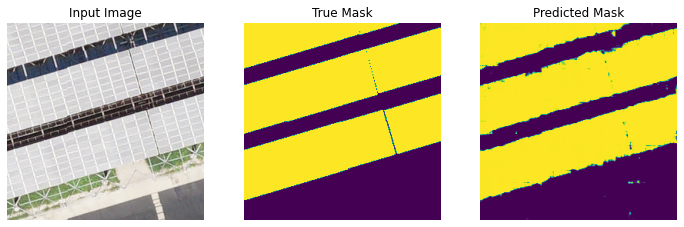

Epoch 150/150
9/9 [==============================] - 1s 154ms/step - loss: 0.0301 - dice_coef: 0.9699 - binary_accuracy: 0.9917 - val_loss: 0.2341 - val_dice_coef: 0.7659 - val_binary_accuracy: 0.9771


In [34]:
early_stop = tf.keras.callbacks.EarlyStopping(patience=16,restore_best_weights=True)

class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs=None):
        if (epoch + 1) % 3 == 0:
            show_predictions(sample_image, sample_mask)
EPOCHS = 150
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

model_history = model.fit(train_dataset, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_data=valid_dataset,
                          callbacks=[DisplayCallback()])


In [38]:
model.save("unet.h5")

In [51]:
model.metrics_names

['loss', 'dice_coef', 'binary_accuracy']

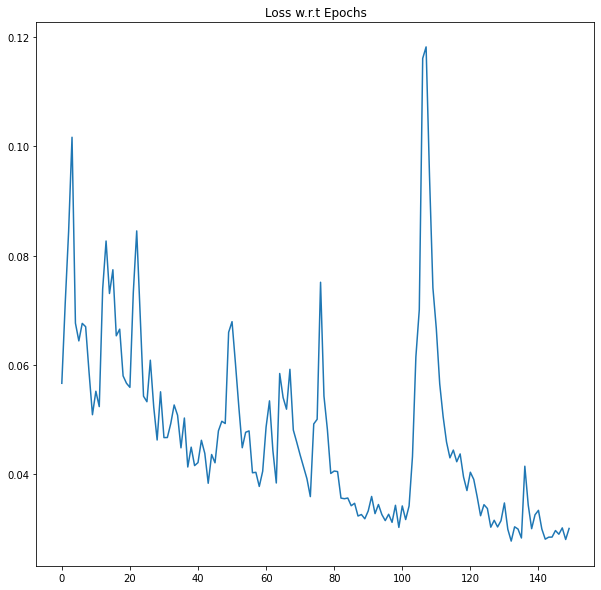

In [59]:
plt.figure(figsize=(10,10))
plt.plot(model_history.history['loss'])
plt.title("Loss w.r.t Epochs")
plt.show()

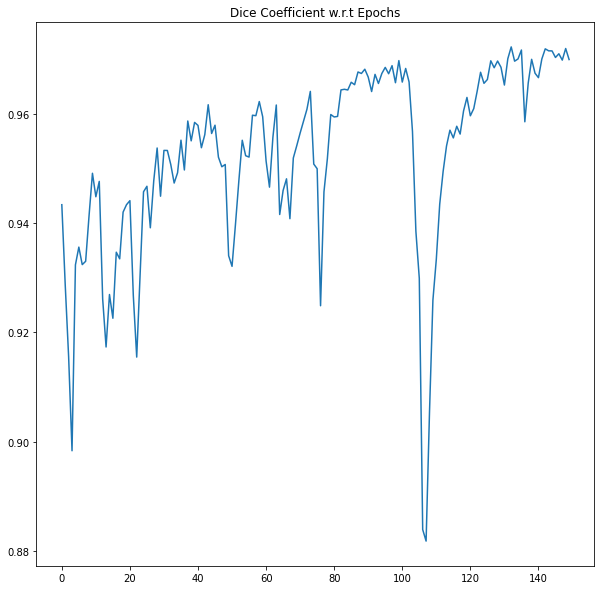

In [60]:
plt.figure(figsize=(10,10))
plt.plot(model_history.history['dice_coef'])
plt.title("Dice Coefficient w.r.t Epochs")
plt.show()

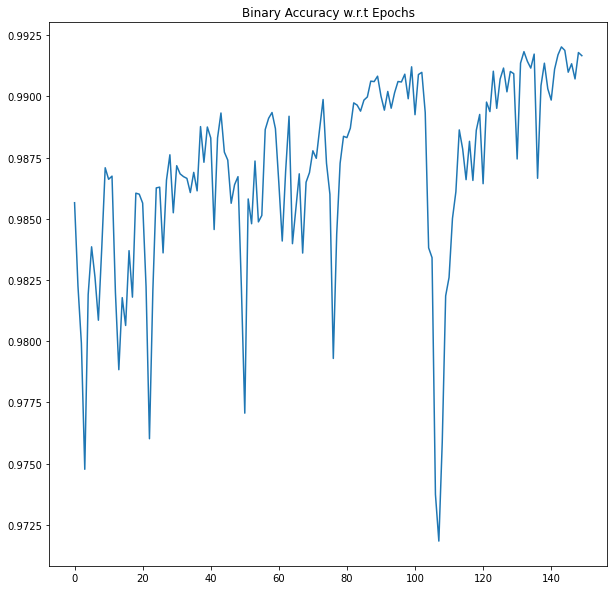

In [61]:
plt.figure(figsize=(10,10))
plt.plot(model_history.history['binary_accuracy'])
plt.title("Binary Accuracy w.r.t Epochs")
plt.show()

### Linear relation to the no. of epochs found

Epoch 1/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0272 - dice_coef: 0.9728 - binary_accuracy: 0.9921 - val_loss: 0.2335 - val_dice_coef: 0.7665 - val_binary_accuracy: 0.9776
Epoch 2/200
1/1 [==============================] - 0s 20ms/step


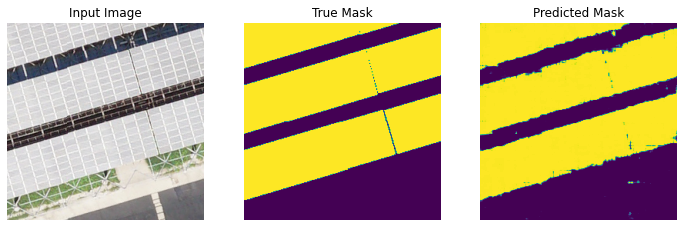

Epoch 3/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0302 - dice_coef: 0.9698 - binary_accuracy: 0.9915 - val_loss: 0.2333 - val_dice_coef: 0.7667 - val_binary_accuracy: 0.9774
Epoch 4/200
9/9 [==============================] - 1s 133ms/step - loss: 0.0268 - dice_coef: 0.9732 - binary_accuracy: 0.9919 - val_loss: 0.2329 - val_dice_coef: 0.7671 - val_binary_accuracy: 0.9773
Epoch 5/200
1/1 [==============================] - 0s 20ms/step


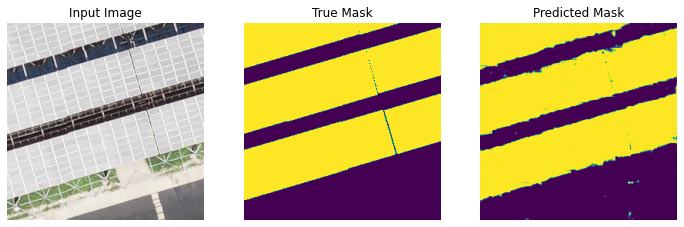

Epoch 6/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0294 - dice_coef: 0.9706 - binary_accuracy: 0.9908 - val_loss: 0.2332 - val_dice_coef: 0.7668 - val_binary_accuracy: 0.9771
Epoch 7/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0280 - dice_coef: 0.9720 - binary_accuracy: 0.9921 - val_loss: 0.2305 - val_dice_coef: 0.7695 - val_binary_accuracy: 0.9785
Epoch 8/200
1/1 [==============================] - 0s 20ms/step


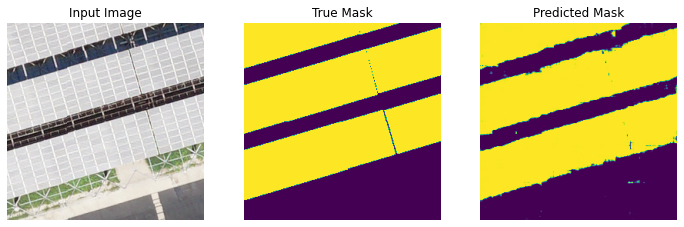

Epoch 9/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0270 - dice_coef: 0.9730 - binary_accuracy: 0.9923 - val_loss: 0.2354 - val_dice_coef: 0.7646 - val_binary_accuracy: 0.9759
Epoch 10/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0294 - dice_coef: 0.9706 - binary_accuracy: 0.9904 - val_loss: 0.2316 - val_dice_coef: 0.7684 - val_binary_accuracy: 0.9794
Epoch 11/200
1/1 [==============================] - 0s 20ms/step


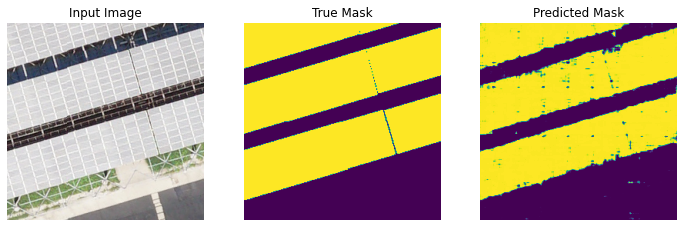

Epoch 12/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0307 - dice_coef: 0.9693 - binary_accuracy: 0.9905 - val_loss: 0.2315 - val_dice_coef: 0.7685 - val_binary_accuracy: 0.9787
Epoch 13/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0311 - dice_coef: 0.9689 - binary_accuracy: 0.9908 - val_loss: 0.2365 - val_dice_coef: 0.7635 - val_binary_accuracy: 0.9772
Epoch 14/200
1/1 [==============================] - 0s 22ms/step


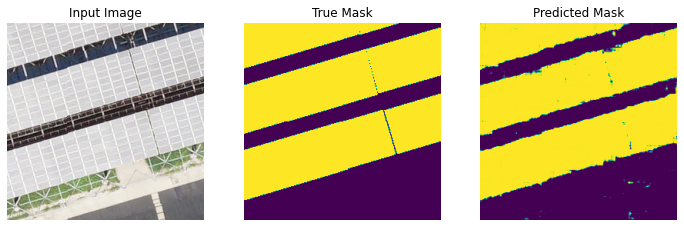

Epoch 15/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0267 - dice_coef: 0.9733 - binary_accuracy: 0.9917 - val_loss: 0.2336 - val_dice_coef: 0.7664 - val_binary_accuracy: 0.9778
Epoch 16/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0258 - dice_coef: 0.9742 - binary_accuracy: 0.9925 - val_loss: 0.2389 - val_dice_coef: 0.7611 - val_binary_accuracy: 0.9771
Epoch 17/200
1/1 [==============================] - 0s 21ms/step


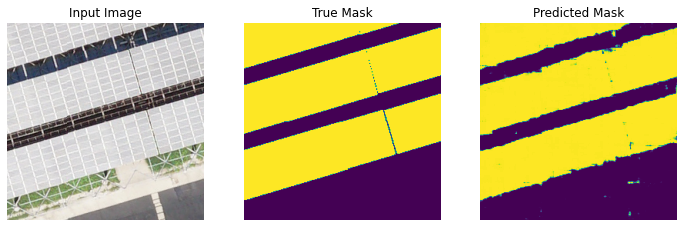

Epoch 18/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0256 - dice_coef: 0.9744 - binary_accuracy: 0.9926 - val_loss: 0.2336 - val_dice_coef: 0.7664 - val_binary_accuracy: 0.9776
Epoch 19/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0253 - dice_coef: 0.9747 - binary_accuracy: 0.9926 - val_loss: 0.2319 - val_dice_coef: 0.7681 - val_binary_accuracy: 0.9791
Epoch 20/200
1/1 [==============================] - 0s 20ms/step


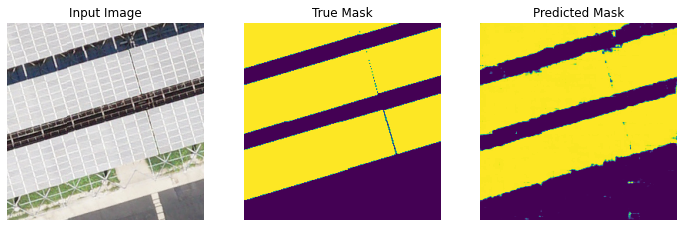

Epoch 21/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0247 - dice_coef: 0.9753 - binary_accuracy: 0.9925 - val_loss: 0.2354 - val_dice_coef: 0.7646 - val_binary_accuracy: 0.9781
Epoch 22/200
9/9 [==============================] - 1s 160ms/step - loss: 0.0257 - dice_coef: 0.9743 - binary_accuracy: 0.9920 - val_loss: 0.2349 - val_dice_coef: 0.7651 - val_binary_accuracy: 0.9787
Epoch 23/200
1/1 [==============================] - 0s 21ms/step


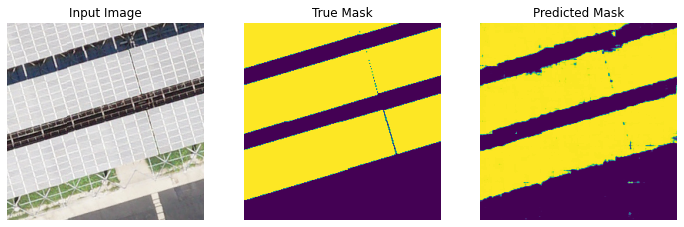

Epoch 24/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0238 - dice_coef: 0.9762 - binary_accuracy: 0.9928 - val_loss: 0.2367 - val_dice_coef: 0.7633 - val_binary_accuracy: 0.9781
Epoch 25/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0254 - dice_coef: 0.9746 - binary_accuracy: 0.9926 - val_loss: 0.2357 - val_dice_coef: 0.7643 - val_binary_accuracy: 0.9773
Epoch 26/200
1/1 [==============================] - 0s 30ms/step


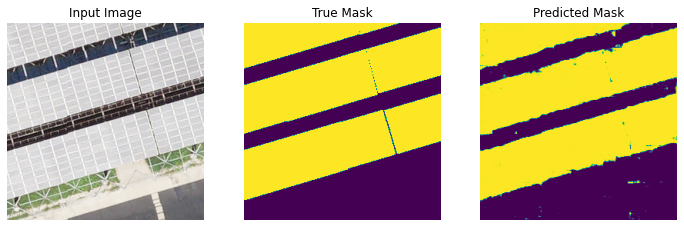

Epoch 27/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0256 - dice_coef: 0.9744 - binary_accuracy: 0.9916 - val_loss: 0.2312 - val_dice_coef: 0.7688 - val_binary_accuracy: 0.9793
Epoch 28/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0246 - dice_coef: 0.9754 - binary_accuracy: 0.9921 - val_loss: 0.2332 - val_dice_coef: 0.7668 - val_binary_accuracy: 0.9788
Epoch 29/200
1/1 [==============================] - 0s 22ms/step


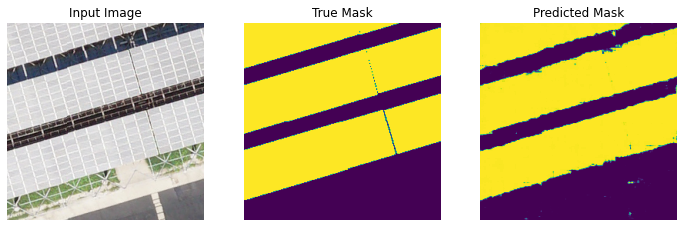

Epoch 30/200
9/9 [==============================] - 1s 151ms/step - loss: 0.0248 - dice_coef: 0.9752 - binary_accuracy: 0.9925 - val_loss: 0.2355 - val_dice_coef: 0.7645 - val_binary_accuracy: 0.9776
Epoch 31/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0229 - dice_coef: 0.9771 - binary_accuracy: 0.9931 - val_loss: 0.2333 - val_dice_coef: 0.7667 - val_binary_accuracy: 0.9787
Epoch 32/200
1/1 [==============================] - 0s 23ms/step


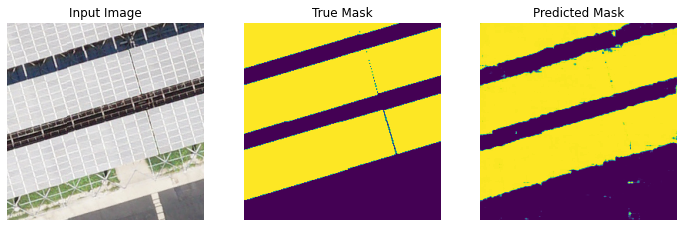

Epoch 33/200
9/9 [==============================] - 1s 151ms/step - loss: 0.0223 - dice_coef: 0.9777 - binary_accuracy: 0.9933 - val_loss: 0.2348 - val_dice_coef: 0.7652 - val_binary_accuracy: 0.9784
Epoch 34/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0220 - dice_coef: 0.9780 - binary_accuracy: 0.9934 - val_loss: 0.2349 - val_dice_coef: 0.7651 - val_binary_accuracy: 0.9778
Epoch 35/200
1/1 [==============================] - 0s 20ms/step


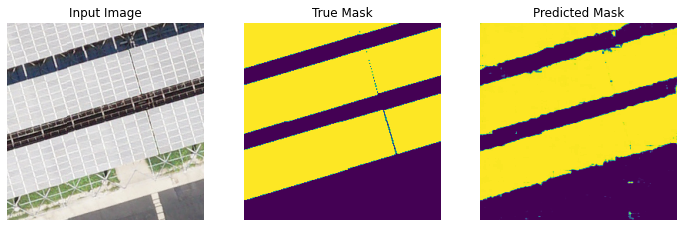

Epoch 36/200
9/9 [==============================] - 1s 134ms/step - loss: 0.0255 - dice_coef: 0.9745 - binary_accuracy: 0.9925 - val_loss: 0.2408 - val_dice_coef: 0.7592 - val_binary_accuracy: 0.9759
Epoch 37/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0309 - dice_coef: 0.9691 - binary_accuracy: 0.9914 - val_loss: 0.2366 - val_dice_coef: 0.7634 - val_binary_accuracy: 0.9765
Epoch 38/200
1/1 [==============================] - 0s 21ms/step


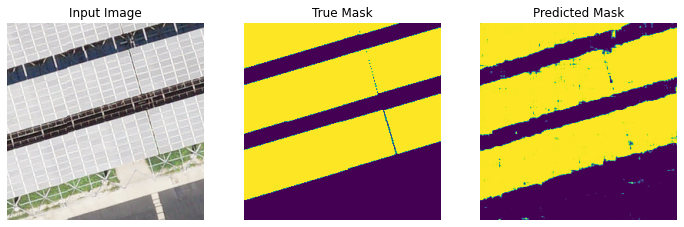

Epoch 39/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0270 - dice_coef: 0.9730 - binary_accuracy: 0.9919 - val_loss: 0.2333 - val_dice_coef: 0.7667 - val_binary_accuracy: 0.9780
Epoch 40/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0243 - dice_coef: 0.9757 - binary_accuracy: 0.9929 - val_loss: 0.2360 - val_dice_coef: 0.7640 - val_binary_accuracy: 0.9767
Epoch 41/200
1/1 [==============================] - 0s 20ms/step


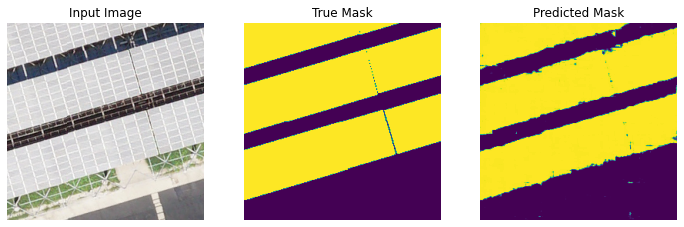

Epoch 42/200
9/9 [==============================] - 1s 133ms/step - loss: 0.0226 - dice_coef: 0.9774 - binary_accuracy: 0.9933 - val_loss: 0.2356 - val_dice_coef: 0.7644 - val_binary_accuracy: 0.9786
Epoch 43/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0219 - dice_coef: 0.9781 - binary_accuracy: 0.9935 - val_loss: 0.2387 - val_dice_coef: 0.7613 - val_binary_accuracy: 0.9761
Epoch 44/200
1/1 [==============================] - 0s 26ms/step


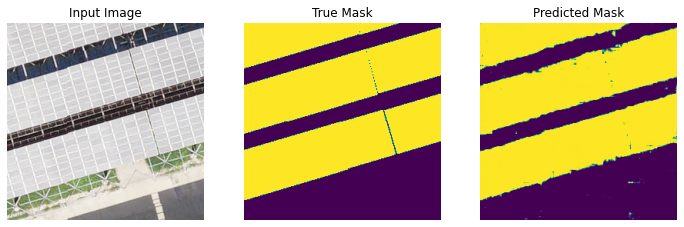

Epoch 45/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0217 - dice_coef: 0.9783 - binary_accuracy: 0.9933 - val_loss: 0.2372 - val_dice_coef: 0.7628 - val_binary_accuracy: 0.9771
Epoch 46/200
9/9 [==============================] - 1s 134ms/step - loss: 0.0213 - dice_coef: 0.9787 - binary_accuracy: 0.9936 - val_loss: 0.2360 - val_dice_coef: 0.7640 - val_binary_accuracy: 0.9778
Epoch 47/200
1/1 [==============================] - 0s 20ms/step


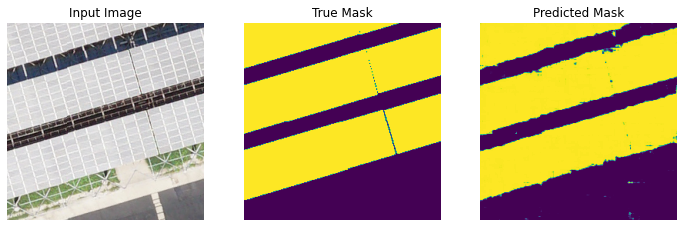

Epoch 48/200
9/9 [==============================] - 1s 132ms/step - loss: 0.0211 - dice_coef: 0.9789 - binary_accuracy: 0.9936 - val_loss: 0.2355 - val_dice_coef: 0.7645 - val_binary_accuracy: 0.9782
Epoch 49/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0218 - dice_coef: 0.9782 - binary_accuracy: 0.9933 - val_loss: 0.2362 - val_dice_coef: 0.7638 - val_binary_accuracy: 0.9788
Epoch 50/200
1/1 [==============================] - 0s 24ms/step


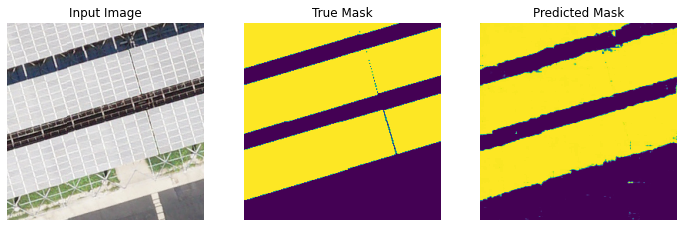

Epoch 51/200
9/9 [==============================] - 1s 145ms/step - loss: 0.0216 - dice_coef: 0.9784 - binary_accuracy: 0.9932 - val_loss: 0.2380 - val_dice_coef: 0.7620 - val_binary_accuracy: 0.9781
Epoch 52/200
9/9 [==============================] - 1s 143ms/step - loss: 0.0220 - dice_coef: 0.9780 - binary_accuracy: 0.9935 - val_loss: 0.2376 - val_dice_coef: 0.7624 - val_binary_accuracy: 0.9778
Epoch 53/200
1/1 [==============================] - 0s 47ms/step


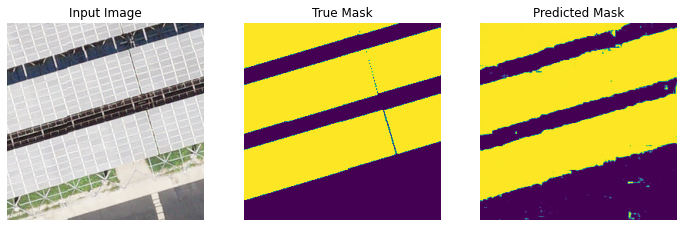

Epoch 54/200
9/9 [==============================] - 1s 149ms/step - loss: 0.0236 - dice_coef: 0.9764 - binary_accuracy: 0.9930 - val_loss: 0.2359 - val_dice_coef: 0.7641 - val_binary_accuracy: 0.9782
Epoch 55/200
9/9 [==============================] - 1s 159ms/step - loss: 0.0223 - dice_coef: 0.9777 - binary_accuracy: 0.9934 - val_loss: 0.2397 - val_dice_coef: 0.7603 - val_binary_accuracy: 0.9764
Epoch 56/200
1/1 [==============================] - 0s 24ms/step


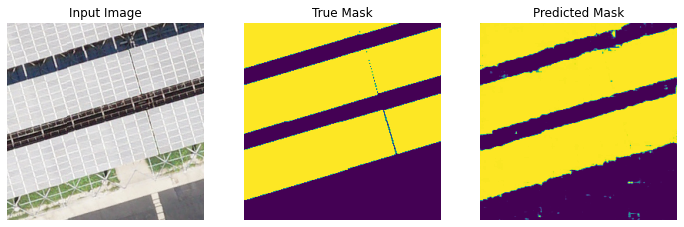

Epoch 57/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0211 - dice_coef: 0.9789 - binary_accuracy: 0.9935 - val_loss: 0.2381 - val_dice_coef: 0.7619 - val_binary_accuracy: 0.9774
Epoch 58/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0203 - dice_coef: 0.9797 - binary_accuracy: 0.9939 - val_loss: 0.2389 - val_dice_coef: 0.7611 - val_binary_accuracy: 0.9775
Epoch 59/200
1/1 [==============================] - 0s 21ms/step


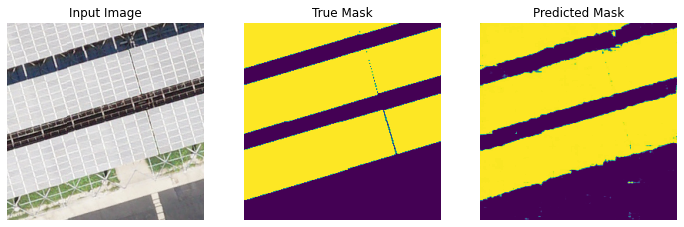

Epoch 60/200
9/9 [==============================] - 1s 134ms/step - loss: 0.0198 - dice_coef: 0.9802 - binary_accuracy: 0.9940 - val_loss: 0.2391 - val_dice_coef: 0.7609 - val_binary_accuracy: 0.9783
Epoch 61/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0199 - dice_coef: 0.9801 - binary_accuracy: 0.9940 - val_loss: 0.2383 - val_dice_coef: 0.7617 - val_binary_accuracy: 0.9783
Epoch 62/200
1/1 [==============================] - 0s 19ms/step


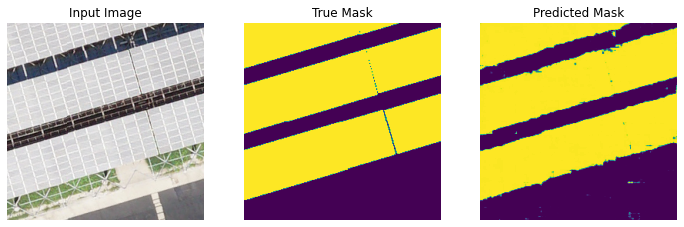

Epoch 63/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0193 - dice_coef: 0.9807 - binary_accuracy: 0.9941 - val_loss: 0.2400 - val_dice_coef: 0.7600 - val_binary_accuracy: 0.9781
Epoch 64/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0190 - dice_coef: 0.9810 - binary_accuracy: 0.9942 - val_loss: 0.2394 - val_dice_coef: 0.7606 - val_binary_accuracy: 0.9778
Epoch 65/200
1/1 [==============================] - 0s 19ms/step


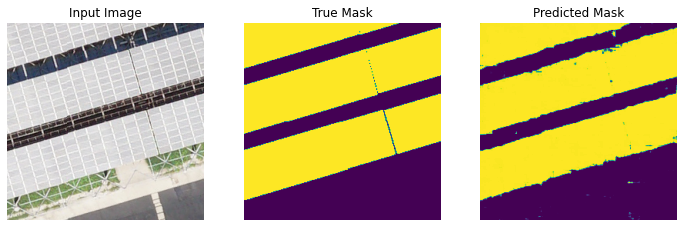

Epoch 66/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0187 - dice_coef: 0.9813 - binary_accuracy: 0.9943 - val_loss: 0.2394 - val_dice_coef: 0.7606 - val_binary_accuracy: 0.9774
Epoch 67/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0191 - dice_coef: 0.9809 - binary_accuracy: 0.9942 - val_loss: 0.2392 - val_dice_coef: 0.7608 - val_binary_accuracy: 0.9778
Epoch 68/200
1/1 [==============================] - 0s 19ms/step


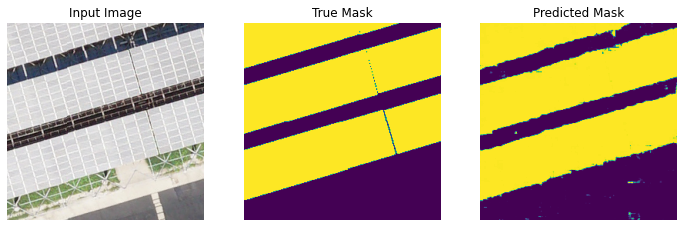

Epoch 69/200
9/9 [==============================] - 1s 134ms/step - loss: 0.0249 - dice_coef: 0.9751 - binary_accuracy: 0.9928 - val_loss: 0.2438 - val_dice_coef: 0.7562 - val_binary_accuracy: 0.9766
Epoch 70/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0259 - dice_coef: 0.9741 - binary_accuracy: 0.9931 - val_loss: 0.2544 - val_dice_coef: 0.7456 - val_binary_accuracy: 0.9723
Epoch 71/200
1/1 [==============================] - 0s 21ms/step


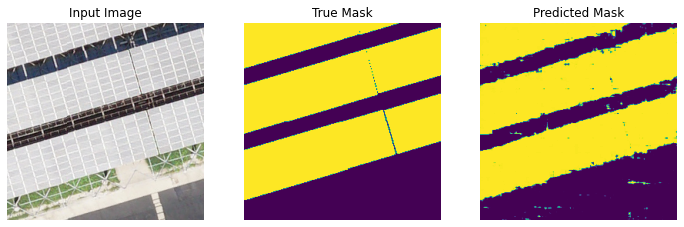

Epoch 72/200
9/9 [==============================] - 1s 134ms/step - loss: 0.0302 - dice_coef: 0.9698 - binary_accuracy: 0.9915 - val_loss: 0.2573 - val_dice_coef: 0.7427 - val_binary_accuracy: 0.9735
Epoch 73/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0258 - dice_coef: 0.9742 - binary_accuracy: 0.9928 - val_loss: 0.2499 - val_dice_coef: 0.7501 - val_binary_accuracy: 0.9758
Epoch 74/200
1/1 [==============================] - 0s 23ms/step


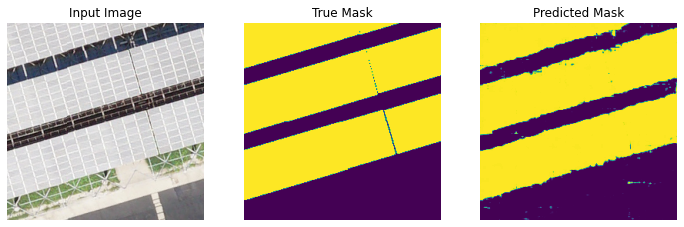

Epoch 75/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0239 - dice_coef: 0.9761 - binary_accuracy: 0.9932 - val_loss: 0.2438 - val_dice_coef: 0.7562 - val_binary_accuracy: 0.9757
Epoch 76/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0229 - dice_coef: 0.9771 - binary_accuracy: 0.9933 - val_loss: 0.2411 - val_dice_coef: 0.7589 - val_binary_accuracy: 0.9778
Epoch 77/200
1/1 [==============================] - 0s 25ms/step


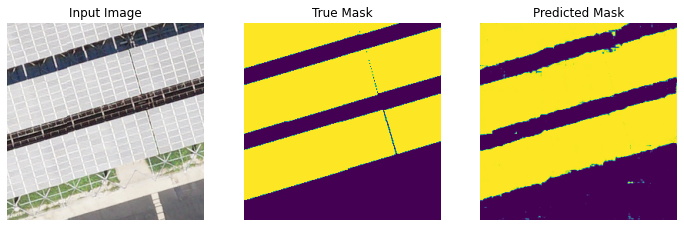

Epoch 78/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0255 - dice_coef: 0.9745 - binary_accuracy: 0.9913 - val_loss: 0.2439 - val_dice_coef: 0.7561 - val_binary_accuracy: 0.9772
Epoch 79/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0242 - dice_coef: 0.9758 - binary_accuracy: 0.9928 - val_loss: 0.2467 - val_dice_coef: 0.7533 - val_binary_accuracy: 0.9765
Epoch 80/200
1/1 [==============================] - 0s 23ms/step


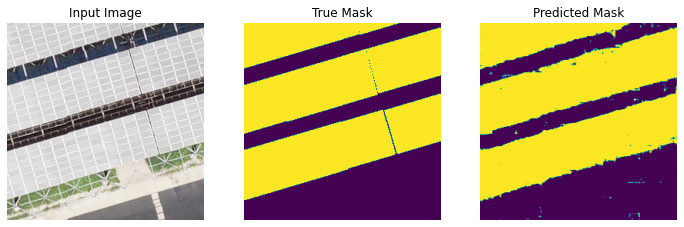

Epoch 81/200
9/9 [==============================] - 1s 135ms/step - loss: 0.0268 - dice_coef: 0.9732 - binary_accuracy: 0.9920 - val_loss: 0.2425 - val_dice_coef: 0.7575 - val_binary_accuracy: 0.9758
Epoch 82/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0260 - dice_coef: 0.9740 - binary_accuracy: 0.9924 - val_loss: 0.2383 - val_dice_coef: 0.7617 - val_binary_accuracy: 0.9772
Epoch 83/200
1/1 [==============================] - 0s 19ms/step


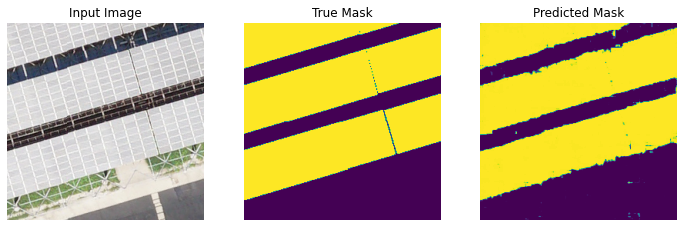

Epoch 84/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0231 - dice_coef: 0.9769 - binary_accuracy: 0.9932 - val_loss: 0.2383 - val_dice_coef: 0.7617 - val_binary_accuracy: 0.9776
Epoch 85/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0225 - dice_coef: 0.9775 - binary_accuracy: 0.9934 - val_loss: 0.2384 - val_dice_coef: 0.7616 - val_binary_accuracy: 0.9777
Epoch 86/200
1/1 [==============================] - 0s 23ms/step


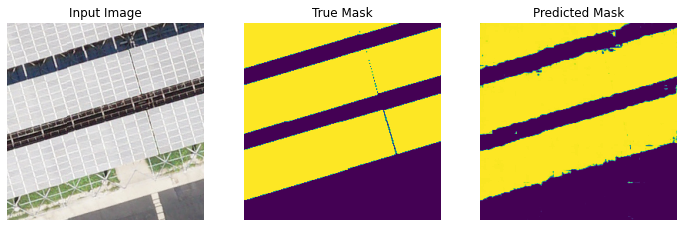

Epoch 87/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0217 - dice_coef: 0.9783 - binary_accuracy: 0.9931 - val_loss: 0.2391 - val_dice_coef: 0.7609 - val_binary_accuracy: 0.9770
Epoch 88/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0196 - dice_coef: 0.9804 - binary_accuracy: 0.9941 - val_loss: 0.2399 - val_dice_coef: 0.7601 - val_binary_accuracy: 0.9777
Epoch 89/200
1/1 [==============================] - 0s 25ms/step


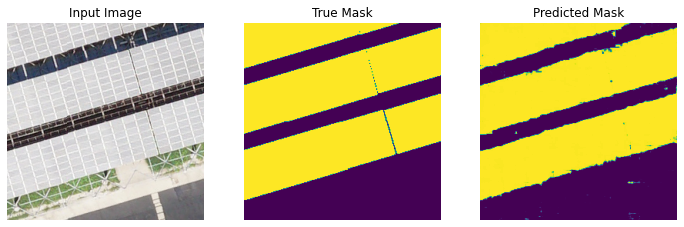

Epoch 90/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0198 - dice_coef: 0.9802 - binary_accuracy: 0.9940 - val_loss: 0.2415 - val_dice_coef: 0.7585 - val_binary_accuracy: 0.9779
Epoch 91/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0227 - dice_coef: 0.9773 - binary_accuracy: 0.9924 - val_loss: 0.2388 - val_dice_coef: 0.7612 - val_binary_accuracy: 0.9777
Epoch 92/200
1/1 [==============================] - 0s 30ms/step


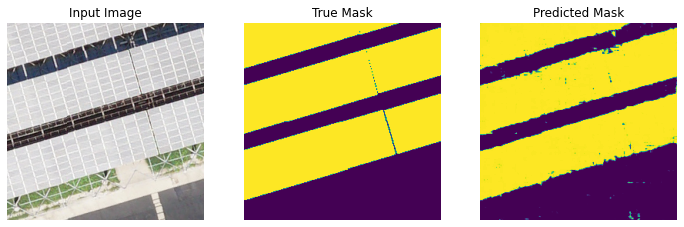

Epoch 93/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0240 - dice_coef: 0.9760 - binary_accuracy: 0.9933 - val_loss: 0.2410 - val_dice_coef: 0.7590 - val_binary_accuracy: 0.9769
Epoch 94/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0231 - dice_coef: 0.9769 - binary_accuracy: 0.9931 - val_loss: 0.2439 - val_dice_coef: 0.7561 - val_binary_accuracy: 0.9752
Epoch 95/200
1/1 [==============================] - 0s 23ms/step


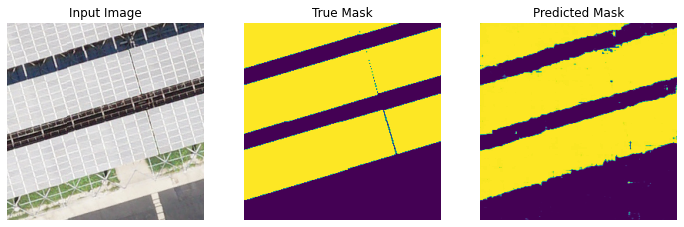

Epoch 96/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0202 - dice_coef: 0.9798 - binary_accuracy: 0.9939 - val_loss: 0.2411 - val_dice_coef: 0.7589 - val_binary_accuracy: 0.9761
Epoch 97/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0197 - dice_coef: 0.9803 - binary_accuracy: 0.9940 - val_loss: 0.2390 - val_dice_coef: 0.7610 - val_binary_accuracy: 0.9772
Epoch 98/200
1/1 [==============================] - 0s 23ms/step


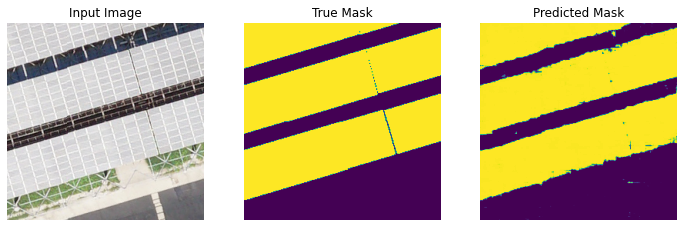

Epoch 99/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0190 - dice_coef: 0.9810 - binary_accuracy: 0.9942 - val_loss: 0.2382 - val_dice_coef: 0.7618 - val_binary_accuracy: 0.9786
Epoch 100/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0192 - dice_coef: 0.9808 - binary_accuracy: 0.9941 - val_loss: 0.2403 - val_dice_coef: 0.7597 - val_binary_accuracy: 0.9762
Epoch 101/200
1/1 [==============================] - 0s 25ms/step


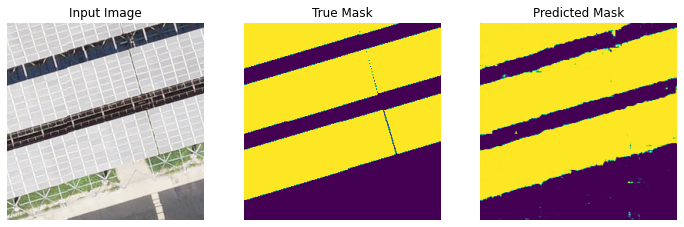

Epoch 102/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0209 - dice_coef: 0.9791 - binary_accuracy: 0.9939 - val_loss: 0.2372 - val_dice_coef: 0.7628 - val_binary_accuracy: 0.9784
Epoch 103/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0196 - dice_coef: 0.9804 - binary_accuracy: 0.9942 - val_loss: 0.2381 - val_dice_coef: 0.7620 - val_binary_accuracy: 0.9773
Epoch 104/200
1/1 [==============================] - 0s 27ms/step


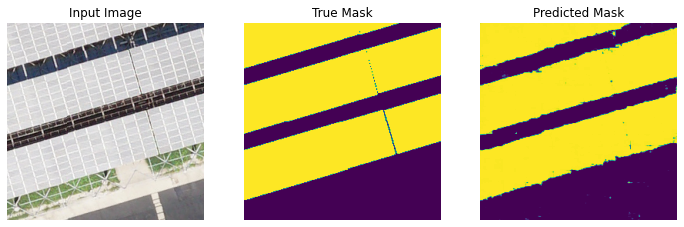

Epoch 105/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0178 - dice_coef: 0.9822 - binary_accuracy: 0.9946 - val_loss: 0.2384 - val_dice_coef: 0.7616 - val_binary_accuracy: 0.9782
Epoch 106/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0182 - dice_coef: 0.9818 - binary_accuracy: 0.9946 - val_loss: 0.2415 - val_dice_coef: 0.7585 - val_binary_accuracy: 0.9765
Epoch 107/200
1/1 [==============================] - 0s 25ms/step


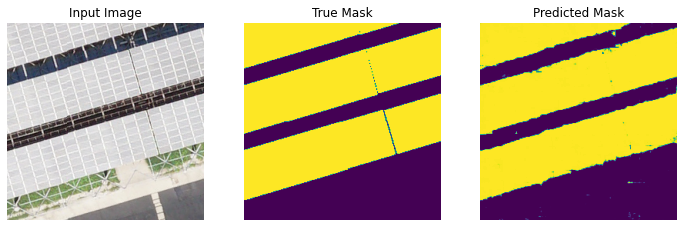

Epoch 108/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0183 - dice_coef: 0.9817 - binary_accuracy: 0.9942 - val_loss: 0.2428 - val_dice_coef: 0.7572 - val_binary_accuracy: 0.9754
Epoch 109/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0230 - dice_coef: 0.9770 - binary_accuracy: 0.9934 - val_loss: 0.2369 - val_dice_coef: 0.7631 - val_binary_accuracy: 0.9771
Epoch 110/200
1/1 [==============================] - 0s 29ms/step


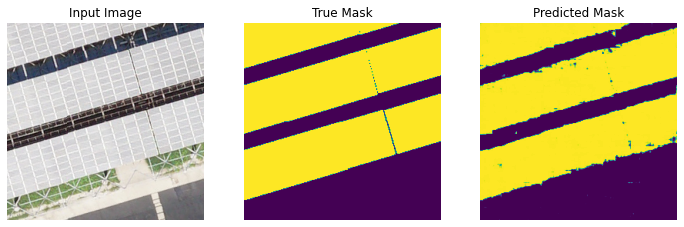

Epoch 111/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0223 - dice_coef: 0.9777 - binary_accuracy: 0.9933 - val_loss: 0.2416 - val_dice_coef: 0.7584 - val_binary_accuracy: 0.9774
Epoch 112/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0260 - dice_coef: 0.9740 - binary_accuracy: 0.9921 - val_loss: 0.2535 - val_dice_coef: 0.7465 - val_binary_accuracy: 0.9751
Epoch 113/200
1/1 [==============================] - 0s 27ms/step


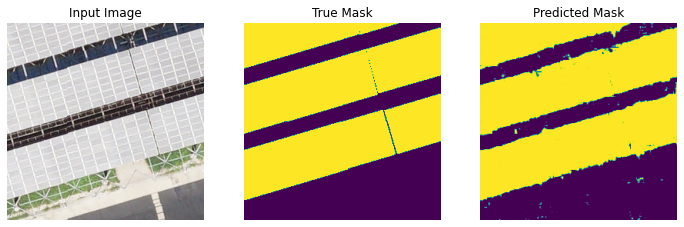

Epoch 114/200
9/9 [==============================] - 1s 150ms/step - loss: 0.0262 - dice_coef: 0.9738 - binary_accuracy: 0.9915 - val_loss: 0.2445 - val_dice_coef: 0.7555 - val_binary_accuracy: 0.9757
Epoch 115/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0245 - dice_coef: 0.9755 - binary_accuracy: 0.9930 - val_loss: 0.2445 - val_dice_coef: 0.7555 - val_binary_accuracy: 0.9756
Epoch 116/200
1/1 [==============================] - 0s 27ms/step


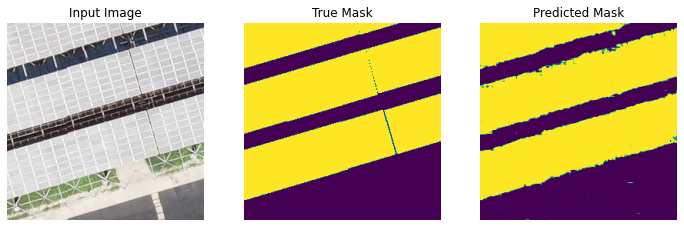

Epoch 117/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0263 - dice_coef: 0.9737 - binary_accuracy: 0.9927 - val_loss: 0.2482 - val_dice_coef: 0.7518 - val_binary_accuracy: 0.9738
Epoch 118/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0271 - dice_coef: 0.9729 - binary_accuracy: 0.9927 - val_loss: 0.2493 - val_dice_coef: 0.7507 - val_binary_accuracy: 0.9755
Epoch 119/200
1/1 [==============================] - 0s 29ms/step


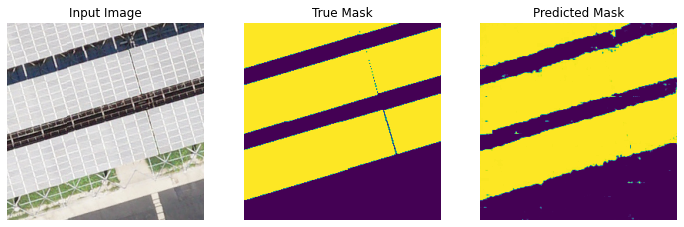

Epoch 120/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0234 - dice_coef: 0.9766 - binary_accuracy: 0.9932 - val_loss: 0.2403 - val_dice_coef: 0.7597 - val_binary_accuracy: 0.9758
Epoch 121/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0199 - dice_coef: 0.9801 - binary_accuracy: 0.9940 - val_loss: 0.2368 - val_dice_coef: 0.7632 - val_binary_accuracy: 0.9775
Epoch 122/200
1/1 [==============================] - 0s 30ms/step


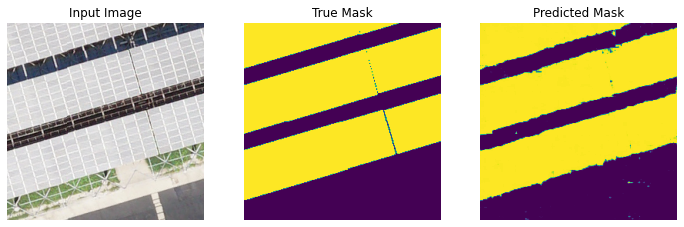

Epoch 123/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0210 - dice_coef: 0.9790 - binary_accuracy: 0.9935 - val_loss: 0.2408 - val_dice_coef: 0.7592 - val_binary_accuracy: 0.9772
Epoch 124/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0181 - dice_coef: 0.9819 - binary_accuracy: 0.9945 - val_loss: 0.2374 - val_dice_coef: 0.7626 - val_binary_accuracy: 0.9783
Epoch 125/200
1/1 [==============================] - 0s 30ms/step


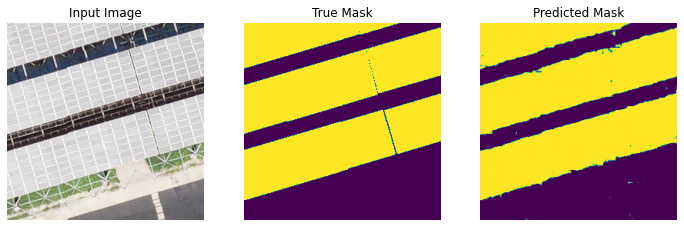

Epoch 126/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0183 - dice_coef: 0.9817 - binary_accuracy: 0.9944 - val_loss: 0.2384 - val_dice_coef: 0.7616 - val_binary_accuracy: 0.9772
Epoch 127/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0189 - dice_coef: 0.9811 - binary_accuracy: 0.9941 - val_loss: 0.2391 - val_dice_coef: 0.7609 - val_binary_accuracy: 0.9781
Epoch 128/200
1/1 [==============================] - 0s 29ms/step


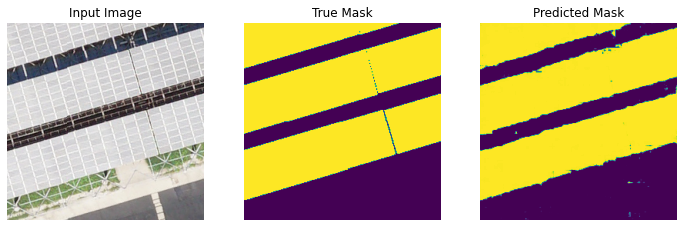

Epoch 129/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0177 - dice_coef: 0.9823 - binary_accuracy: 0.9945 - val_loss: 0.2392 - val_dice_coef: 0.7608 - val_binary_accuracy: 0.9776
Epoch 130/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0180 - dice_coef: 0.9820 - binary_accuracy: 0.9944 - val_loss: 0.2431 - val_dice_coef: 0.7569 - val_binary_accuracy: 0.9760
Epoch 131/200
1/1 [==============================] - 0s 32ms/step


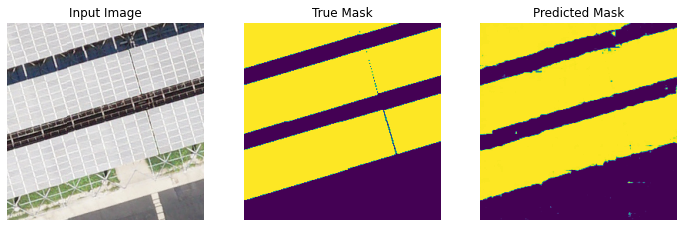

Epoch 132/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0174 - dice_coef: 0.9826 - binary_accuracy: 0.9948 - val_loss: 0.2407 - val_dice_coef: 0.7593 - val_binary_accuracy: 0.9771
Epoch 133/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0172 - dice_coef: 0.9828 - binary_accuracy: 0.9947 - val_loss: 0.2389 - val_dice_coef: 0.7611 - val_binary_accuracy: 0.9779
Epoch 134/200
1/1 [==============================] - 0s 31ms/step


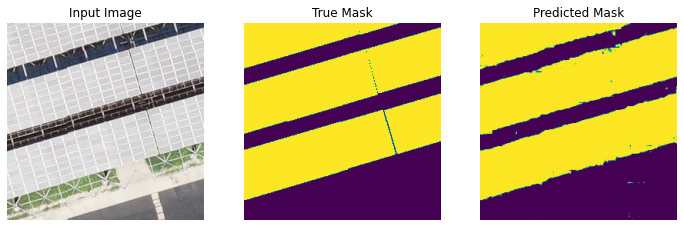

Epoch 135/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0166 - dice_coef: 0.9834 - binary_accuracy: 0.9949 - val_loss: 0.2410 - val_dice_coef: 0.7590 - val_binary_accuracy: 0.9777
Epoch 136/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0163 - dice_coef: 0.9837 - binary_accuracy: 0.9950 - val_loss: 0.2423 - val_dice_coef: 0.7577 - val_binary_accuracy: 0.9769
Epoch 137/200
1/1 [==============================] - 0s 24ms/step


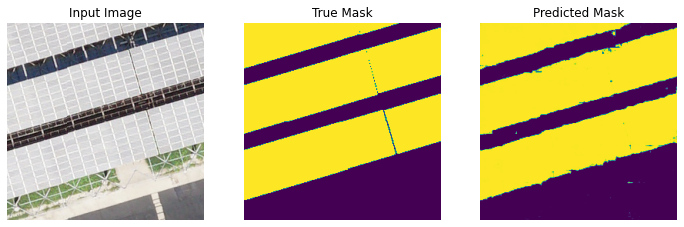

Epoch 138/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0165 - dice_coef: 0.9835 - binary_accuracy: 0.9950 - val_loss: 0.2418 - val_dice_coef: 0.7582 - val_binary_accuracy: 0.9778
Epoch 139/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0165 - dice_coef: 0.9835 - binary_accuracy: 0.9950 - val_loss: 0.2422 - val_dice_coef: 0.7578 - val_binary_accuracy: 0.9760
Epoch 140/200
1/1 [==============================] - 0s 28ms/step


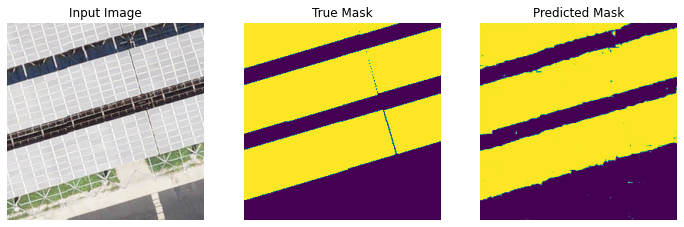

Epoch 141/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0158 - dice_coef: 0.9842 - binary_accuracy: 0.9952 - val_loss: 0.2421 - val_dice_coef: 0.7579 - val_binary_accuracy: 0.9768
Epoch 142/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0164 - dice_coef: 0.9836 - binary_accuracy: 0.9950 - val_loss: 0.2425 - val_dice_coef: 0.7575 - val_binary_accuracy: 0.9771
Epoch 143/200
1/1 [==============================] - 0s 36ms/step


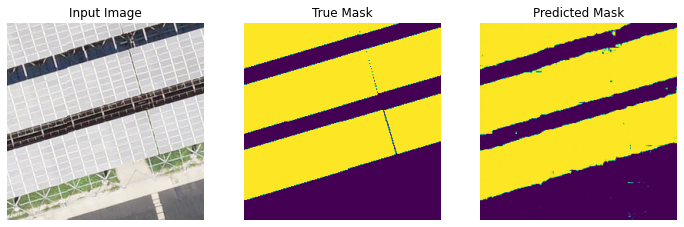

Epoch 144/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0161 - dice_coef: 0.9839 - binary_accuracy: 0.9951 - val_loss: 0.2431 - val_dice_coef: 0.7569 - val_binary_accuracy: 0.9773
Epoch 145/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0160 - dice_coef: 0.9840 - binary_accuracy: 0.9951 - val_loss: 0.2434 - val_dice_coef: 0.7566 - val_binary_accuracy: 0.9773
Epoch 146/200
1/1 [==============================] - 0s 31ms/step


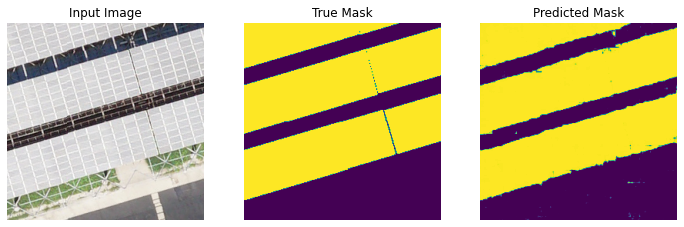

Epoch 147/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0156 - dice_coef: 0.9844 - binary_accuracy: 0.9953 - val_loss: 0.2430 - val_dice_coef: 0.7570 - val_binary_accuracy: 0.9773
Epoch 148/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0162 - dice_coef: 0.9838 - binary_accuracy: 0.9952 - val_loss: 0.2463 - val_dice_coef: 0.7537 - val_binary_accuracy: 0.9768
Epoch 149/200
1/1 [==============================] - 0s 32ms/step


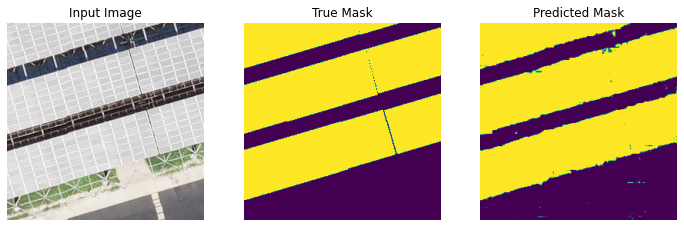

Epoch 150/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0174 - dice_coef: 0.9826 - binary_accuracy: 0.9949 - val_loss: 0.2478 - val_dice_coef: 0.7522 - val_binary_accuracy: 0.9770
Epoch 151/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0169 - dice_coef: 0.9831 - binary_accuracy: 0.9949 - val_loss: 0.2450 - val_dice_coef: 0.7550 - val_binary_accuracy: 0.9778
Epoch 152/200
1/1 [==============================] - 0s 30ms/step


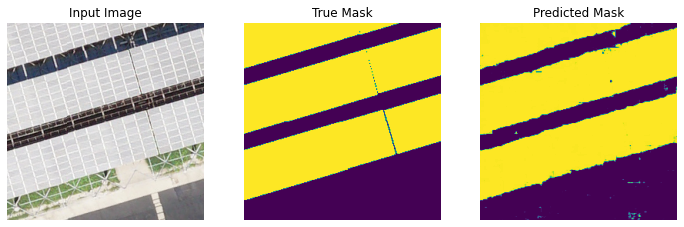

Epoch 153/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0164 - dice_coef: 0.9836 - binary_accuracy: 0.9951 - val_loss: 0.2432 - val_dice_coef: 0.7568 - val_binary_accuracy: 0.9777
Epoch 154/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0176 - dice_coef: 0.9824 - binary_accuracy: 0.9947 - val_loss: 0.2439 - val_dice_coef: 0.7561 - val_binary_accuracy: 0.9759
Epoch 155/200
1/1 [==============================] - 0s 36ms/step


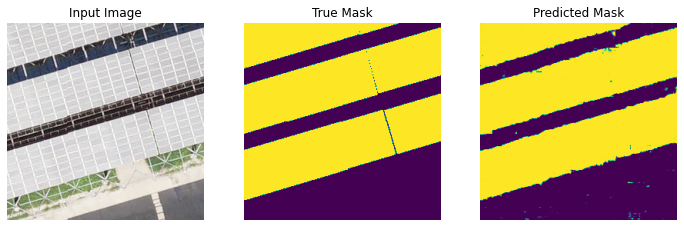

Epoch 156/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0157 - dice_coef: 0.9843 - binary_accuracy: 0.9953 - val_loss: 0.2442 - val_dice_coef: 0.7558 - val_binary_accuracy: 0.9771
Epoch 157/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0153 - dice_coef: 0.9847 - binary_accuracy: 0.9954 - val_loss: 0.2465 - val_dice_coef: 0.7535 - val_binary_accuracy: 0.9765
Epoch 158/200
1/1 [==============================] - 0s 26ms/step


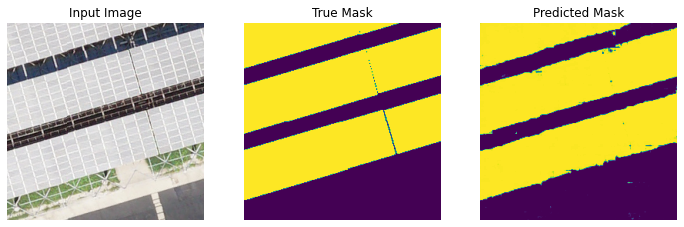

Epoch 159/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0160 - dice_coef: 0.9840 - binary_accuracy: 0.9948 - val_loss: 0.2450 - val_dice_coef: 0.7550 - val_binary_accuracy: 0.9769
Epoch 160/200
9/9 [==============================] - 1s 136ms/step - loss: 0.0151 - dice_coef: 0.9849 - binary_accuracy: 0.9955 - val_loss: 0.2450 - val_dice_coef: 0.7550 - val_binary_accuracy: 0.9775
Epoch 161/200
1/1 [==============================] - 0s 36ms/step


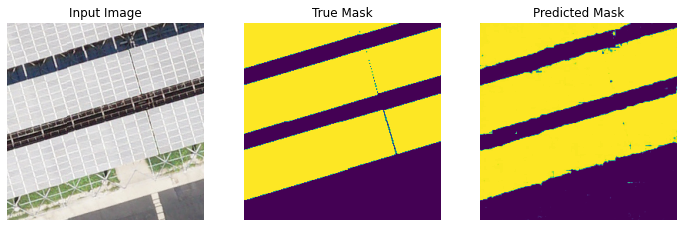

Epoch 162/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0158 - dice_coef: 0.9842 - binary_accuracy: 0.9952 - val_loss: 0.2431 - val_dice_coef: 0.7569 - val_binary_accuracy: 0.9773
Epoch 163/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0158 - dice_coef: 0.9842 - binary_accuracy: 0.9953 - val_loss: 0.2476 - val_dice_coef: 0.7524 - val_binary_accuracy: 0.9777
Epoch 164/200
1/1 [==============================] - 0s 29ms/step


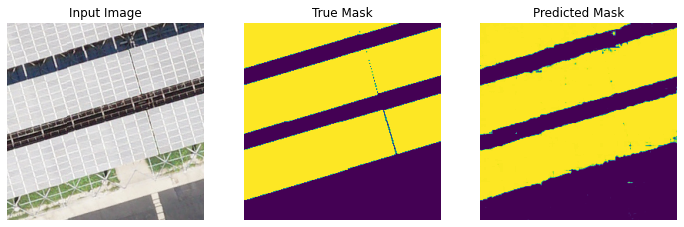

Epoch 165/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0159 - dice_coef: 0.9841 - binary_accuracy: 0.9953 - val_loss: 0.2445 - val_dice_coef: 0.7555 - val_binary_accuracy: 0.9772
Epoch 166/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0157 - dice_coef: 0.9843 - binary_accuracy: 0.9954 - val_loss: 0.2474 - val_dice_coef: 0.7526 - val_binary_accuracy: 0.9753
Epoch 167/200
1/1 [==============================] - 0s 36ms/step


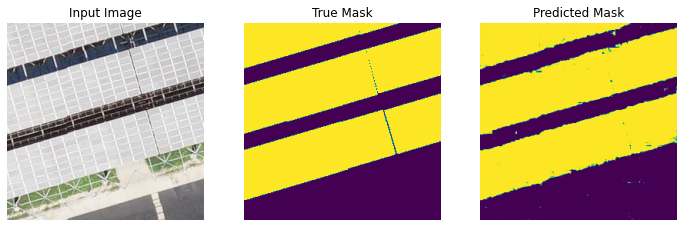

Epoch 168/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0158 - dice_coef: 0.9842 - binary_accuracy: 0.9951 - val_loss: 0.2491 - val_dice_coef: 0.7509 - val_binary_accuracy: 0.9765
Epoch 169/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0167 - dice_coef: 0.9833 - binary_accuracy: 0.9950 - val_loss: 0.2469 - val_dice_coef: 0.7531 - val_binary_accuracy: 0.9771
Epoch 170/200
1/1 [==============================] - 0s 30ms/step


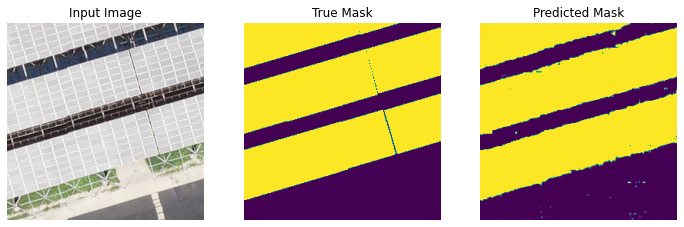

Epoch 171/200
9/9 [==============================] - 1s 139ms/step - loss: 0.0193 - dice_coef: 0.9807 - binary_accuracy: 0.9945 - val_loss: 0.2456 - val_dice_coef: 0.7544 - val_binary_accuracy: 0.9766
Epoch 172/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0182 - dice_coef: 0.9818 - binary_accuracy: 0.9945 - val_loss: 0.2449 - val_dice_coef: 0.7551 - val_binary_accuracy: 0.9773
Epoch 173/200
1/1 [==============================] - 0s 33ms/step


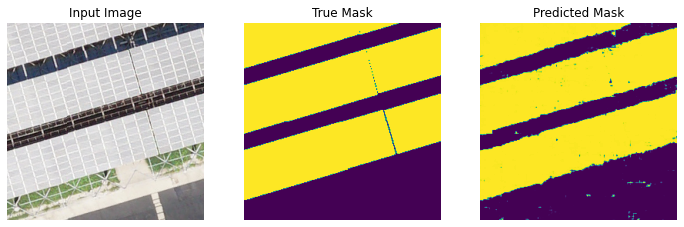

Epoch 174/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0203 - dice_coef: 0.9797 - binary_accuracy: 0.9943 - val_loss: 0.2451 - val_dice_coef: 0.7549 - val_binary_accuracy: 0.9763
Epoch 175/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0209 - dice_coef: 0.9791 - binary_accuracy: 0.9939 - val_loss: 0.2527 - val_dice_coef: 0.7473 - val_binary_accuracy: 0.9756
Epoch 176/200
1/1 [==============================] - 0s 34ms/step


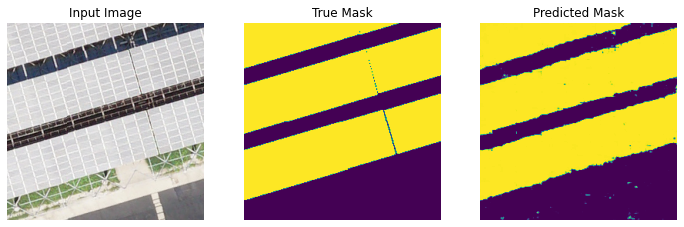

Epoch 177/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0204 - dice_coef: 0.9796 - binary_accuracy: 0.9940 - val_loss: 0.2495 - val_dice_coef: 0.7505 - val_binary_accuracy: 0.9757
Epoch 178/200
9/9 [==============================] - 1s 137ms/step - loss: 0.0195 - dice_coef: 0.9805 - binary_accuracy: 0.9942 - val_loss: 0.2526 - val_dice_coef: 0.7474 - val_binary_accuracy: 0.9739
Epoch 179/200
1/1 [==============================] - 0s 37ms/step


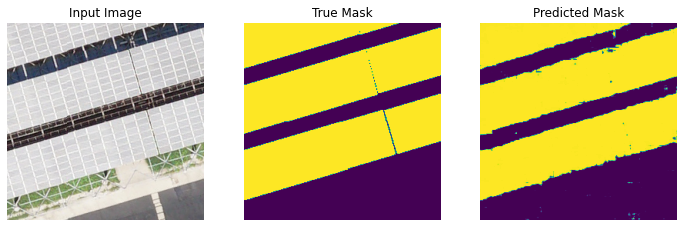

Epoch 180/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0163 - dice_coef: 0.9837 - binary_accuracy: 0.9950 - val_loss: 0.2488 - val_dice_coef: 0.7512 - val_binary_accuracy: 0.9774
Epoch 181/200
9/9 [==============================] - 1s 140ms/step - loss: 0.0168 - dice_coef: 0.9832 - binary_accuracy: 0.9949 - val_loss: 0.2435 - val_dice_coef: 0.7565 - val_binary_accuracy: 0.9772
Epoch 182/200
1/1 [==============================] - 0s 32ms/step


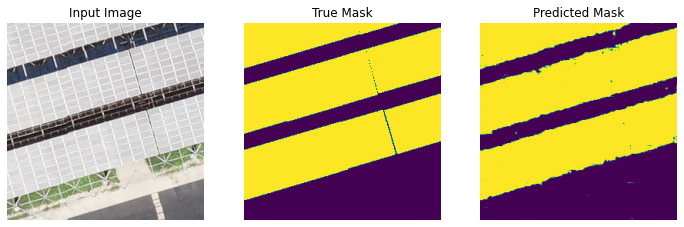

Epoch 183/200
9/9 [==============================] - 1s 141ms/step - loss: 0.0149 - dice_coef: 0.9851 - binary_accuracy: 0.9953 - val_loss: 0.2467 - val_dice_coef: 0.7533 - val_binary_accuracy: 0.9756
Epoch 184/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0148 - dice_coef: 0.9852 - binary_accuracy: 0.9952 - val_loss: 0.2453 - val_dice_coef: 0.7547 - val_binary_accuracy: 0.9754
Epoch 185/200
1/1 [==============================] - 0s 32ms/step


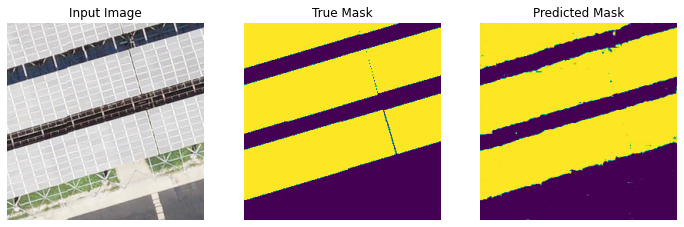

Epoch 186/200
9/9 [==============================] - 1s 140ms/step - loss: 0.0141 - dice_coef: 0.9859 - binary_accuracy: 0.9952 - val_loss: 0.2430 - val_dice_coef: 0.7570 - val_binary_accuracy: 0.9775
Epoch 187/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0132 - dice_coef: 0.9868 - binary_accuracy: 0.9956 - val_loss: 0.2454 - val_dice_coef: 0.7546 - val_binary_accuracy: 0.9762
Epoch 188/200
1/1 [==============================] - 0s 33ms/step


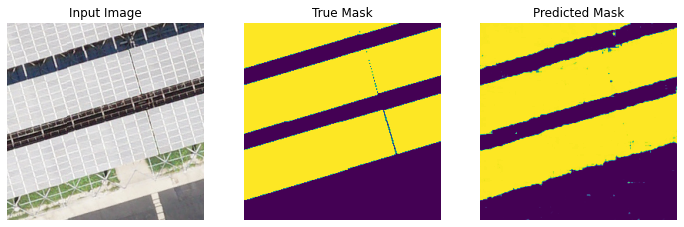

Epoch 189/200
9/9 [==============================] - 1s 141ms/step - loss: 0.0142 - dice_coef: 0.9858 - binary_accuracy: 0.9951 - val_loss: 0.2446 - val_dice_coef: 0.7554 - val_binary_accuracy: 0.9760
Epoch 190/200
9/9 [==============================] - 1s 153ms/step - loss: 0.0141 - dice_coef: 0.9859 - binary_accuracy: 0.9953 - val_loss: 0.2484 - val_dice_coef: 0.7516 - val_binary_accuracy: 0.9760
Epoch 191/200
1/1 [==============================] - 0s 22ms/step


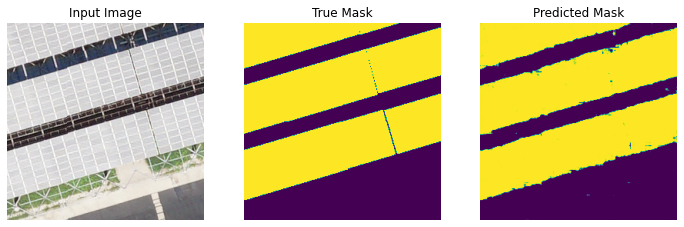

Epoch 192/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0135 - dice_coef: 0.9865 - binary_accuracy: 0.9953 - val_loss: 0.2478 - val_dice_coef: 0.7522 - val_binary_accuracy: 0.9763
Epoch 193/200
9/9 [==============================] - 1s 140ms/step - loss: 0.0136 - dice_coef: 0.9864 - binary_accuracy: 0.9950 - val_loss: 0.2476 - val_dice_coef: 0.7524 - val_binary_accuracy: 0.9761
Epoch 194/200
1/1 [==============================] - 0s 32ms/step


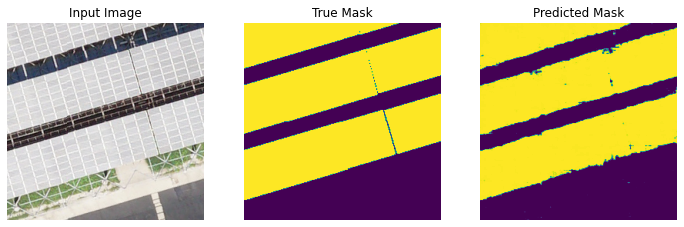

Epoch 195/200
9/9 [==============================] - 1s 154ms/step - loss: 0.0135 - dice_coef: 0.9865 - binary_accuracy: 0.9952 - val_loss: 0.2485 - val_dice_coef: 0.7515 - val_binary_accuracy: 0.9755
Epoch 196/200
9/9 [==============================] - 1s 138ms/step - loss: 0.0131 - dice_coef: 0.9869 - binary_accuracy: 0.9952 - val_loss: 0.2506 - val_dice_coef: 0.7494 - val_binary_accuracy: 0.9745
Epoch 197/200
1/1 [==============================] - 0s 41ms/step


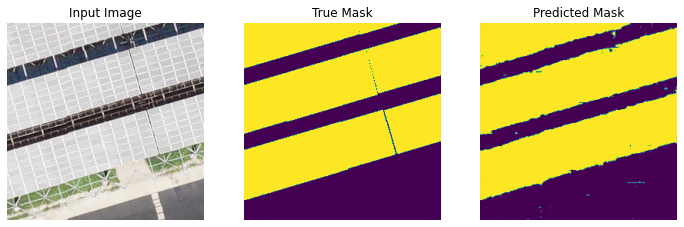

Epoch 198/200
9/9 [==============================] - 1s 152ms/step - loss: 0.0123 - dice_coef: 0.9877 - binary_accuracy: 0.9954 - val_loss: 0.2448 - val_dice_coef: 0.7552 - val_binary_accuracy: 0.9760
Epoch 199/200
9/9 [==============================] - 1s 140ms/step - loss: 0.0143 - dice_coef: 0.9857 - binary_accuracy: 0.9940 - val_loss: 0.2514 - val_dice_coef: 0.7486 - val_binary_accuracy: 0.9754
Epoch 200/200
9/9 [==============================] - 1s 140ms/step - loss: 0.0145 - dice_coef: 0.9855 - binary_accuracy: 0.9950 - val_loss: 0.2461 - val_dice_coef: 0.7539 - val_binary_accuracy: 0.9777


In [62]:
model_history = model.fit(train_dataset, epochs=200,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_data=valid_dataset,
                          callbacks=[DisplayCallback()])

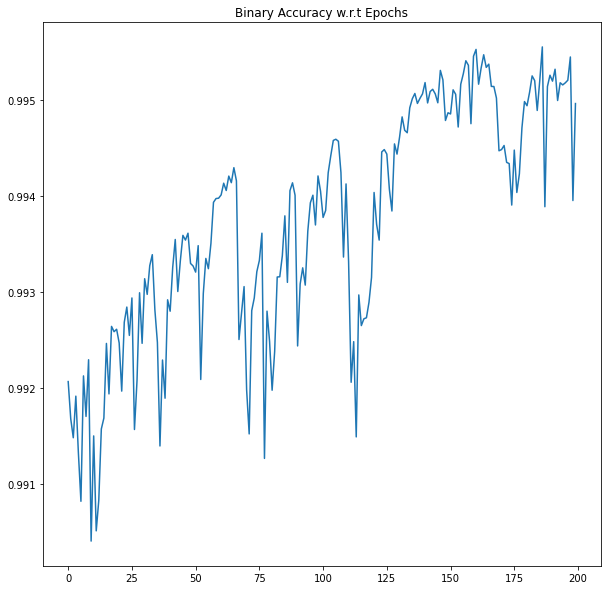

In [63]:
plt.figure(figsize=(10,10))
plt.plot(model_history.history['binary_accuracy'])
plt.title("Binary Accuracy w.r.t Epochs")
plt.show()

The epochs after 150 produce no significant increase in accuracy. Hence, choosing 150 epochs for model evaluation

## Model Evaluation